# TP I : Descentes de Gradient

Ce TP vise à apporter les éléments nécessaires pour comprendre les implementations des descentes de gradients, du moins dans un premier cadre naïf. **C'est un *TP à trous* ; il s'agira de compléter ces trous pour un rendu au plus tard le dimanche 30 août 2020.**

Voici un aperçu des points abordés lors de ce TP.

- Un set de fonctions tests: comment se donne-t-on une fonction numérique? 
- Calculer le gradient d'une fonction: coder une solution en dur ou calcul approché?
- La classe GD: une classe qui sert d'interface pour toutes les descentes qu'on souhaite implémenter. 
- La Descente de Gradient :
    - Calcul du pas : pas constant, *Backtracking*
    - Choix de norme : la classique, la norme $1$
    - Sensibilité aux points initiaux
    - Sensibilité aux nombres de conditionnement
    - Accélération : Momentum, Nesterov, Adam.
- Cas d'application classique: la régression linéaire.
- La Méthode de Newton : 
    - La classe MN
    - Comparaison à la GD.
- Face aux contraintes d'égalité.


## Attendus de rendu

Vous êtes invités à compléter ce TP et à le prolonger par le travail qui vous est suggéré. Votre rendu sera jugé à l'aune de

- votre capacité à produire des algorithmes valides, répondant à la question posée
- l'étude effectuée concernant la sensibilité de vos algorithmes aux hyperparamètres / conditions initiales
- l'analyse comparative proposée quant aux différentes implémentations suggérées 
- les stress-tests auxquels vous aurez confrontés vos implémentations. 

On portera une attention particulière à la *généricité* de votre réponse ; tout comme cela vous est suggéré par la suite on attendra de vous d'appuyer vos affirmations par suffisamment de tests et une appréciation pour les limites de votre analyse.

Ce TP est à rendre par **groupes de 3** et exceptionnellement **2**. Il sera complété d'une soutenance portant sur l'ensemble des TPs.

# Au travail!

In [1]:
import warnings
import math
import numpy as np

## Un set de fonctions tests

Il y a différentes facons de se donner une fonction numérique en machine :

- Symboliquement : on se donne une expression symbolique représentant des sommes, différences, produits, quotients et composées de fonctions usuelles.  Dans ce cadre, l'opération de dérivation est symbolique et les dérivées obtenues par ce biais sont exactes. Une opération d'évaluation est nécessaire pour passer de l'écriture symbolique d'une fonction au calcul de la valeur qu'elle prend en un point. Vous pouvez vous attarder sur la bibliothèque `sympy` sous python, pour plus de détails.

- Numériquement : on envisage une fonction au sens algorithmique du terme, la particularité étant qu'elle a des entrées `floats` et une sortie du même type. Des approximations des fonctions usuelles sont implémentées dans les bibliothèques `math` et `numpy` de python. Dans un soucis de vectorialisation des opérations mathématiques, c'est la seconde bibliothèque qui est utilisée. Évaluer une fonction en un point consiste à appeler celle-ci avec les bonnes entrées flottantes. La dérivée d'une fonction en ce sens est une fonction au même sens qui s'exrime pour une entrée donnée à l'aide d'appels à la fonction de départ. 

- Par approximation : on se préoccupe nullement de la valeur de la fonction en tout point, il nous suffit d'avoir une liste de couples (entrée, sortie) ou encore (point, image) composées de flottants. Dans ce cas on approche les dérivées par les tangentes des droites joignants deux points successifs. 

Dans ce TP notre choix s'arrête sur la plus intuitives des démarches ; l'aspect *fonction au sens informatique du terme*. Vous êtes invités, si vous le souhaitez, à explorer les autres représentations et éventuellement les comparer à celui-ci.

### Structure de données

On va se donner un ensemble de familles de fonctions ; une famille de fonctions est donnée par une classe qui wrap les attributs:

- `name` : une `str` qui contient le nom de la fonction. 
- `convex` : `bool` spécifiant si la famille de fonction est convexe ou non.
- `dim` : `int` la dimension de l'espace de départ.
- `nb_params` : nombre de paramètres de la famille.
- `value` : une fonction qui prend en entrée un `numpy` array et renvoie un `float` en sortie.
- `grad` : fonction gradient de `function`.
- `hess` : fonction hessienne de `function`.
- `HCN` : fonction nombre de conditionnement de la hessienne de `function`.


In [2]:
class test_family():
    
    def __init__(self, name, value, dim, nb_params, convex=None, grad=None, hess=None, HCN=None):
        self.name = name
        self.value = value
        self.dim = dim
        self.nb_params = nb_params
        self.convex = convex
        self.grad = grad
        self.hess = hess
        self.HCN = HCN

### Fonctions du set de test

In [3]:
from matplotlib import pyplot as plt
import seaborn as sns

In [4]:
sns.set_style("whitegrid")

1. Définir des familles de fonctions *convexes* sur $\mathbb{R}$ ayant un nombre de conditionnement uniquement dépendant des paramètres de la famille.  

In [5]:
quad_I_d = {
    "name": "quadratic_1",
    "dim" : 1,
    "nb_params" : 1,
    "convex" : True,
    "value" : (lambda x, gamma: gamma*(x**2) + x + 1),
    "grad"  : (lambda x, gamma: 2*gamma*x + 1),
    "hess"  : (lambda x, gamma: 2*gamma),
    "HCN"   : (lambda x, gamma: 1 ) 
}

quad_I = test_family(**quad_I_d)

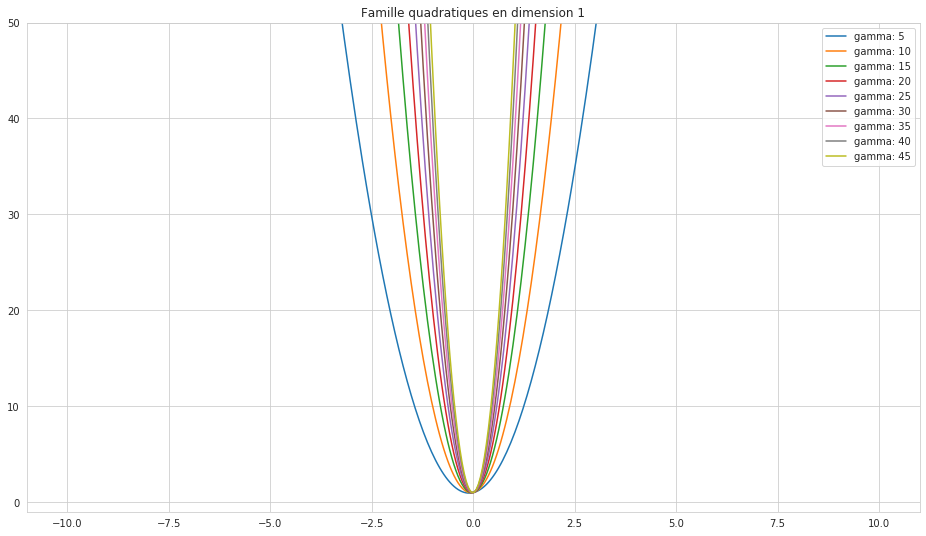

In [6]:
fig, ax = plt.subplots(figsize=(16, 9))
x = np.linspace(-10, 10, 400)
ax.set_ylim(-1, 50)
for gamma in range(5, 50, 5):
    ax.plot(x, quad_I.value(x, gamma), label="gamma: {}".format(gamma))
ax.set_title("Famille quadratiques en dimension 1")
ax.legend()

In [7]:
cubic_I_d = { 
    "name": "cubic_1",
    "dim" : 1,
    "nb_params" : 1,
    "convex" : False,
    "value" : (lambda x, gamma: x**3 + gamma*x**2 + x + 1),
    "grad"  : (lambda x, gamma: 3*x**2 + 2*gamma*x + 1),
    "hess"  : (lambda x, gamma: 6*x + 2*gamma),
    "HCN"   : (lambda x, gamma: 1 ) 
}

cubic_I = test_family(**cubic_I_d)

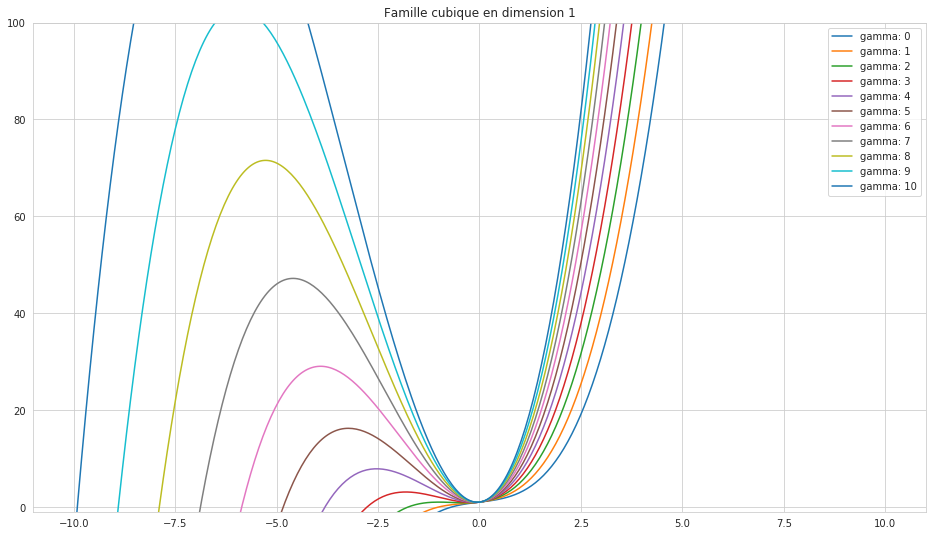

In [8]:
fig, ax = plt.subplots(figsize=(16, 9))
x = np.linspace(-10, 10, 400)
ax.set_ylim(-1, 100)
for gamma in range(0, 11, 1):
    ax.plot(x, cubic_I.value(x, gamma), label="gamma: {}".format(gamma))
ax.set_title("Famille cubique en dimension 1")
ax.legend()

In [9]:
exp_I_d = {
    "name": "exp_1",
    "dim" : 1,
    "nb_params" : 1,
    "convex" : True ,
    "value" : (lambda x, gamma: np.exp(gamma*x) + np.exp(-gamma*x)),
    "grad"  : (lambda x, gamma: gamma*(np.exp(gamma*x) - np.exp(-gamma*x))),
    "hess"  : (lambda x, gamma: (gamma**2)*(np.exp(gamma*x) + np.exp(-gamma*x))),
    "HCN"   : (lambda x, gamma: 1 )    
}

exp_I = test_family(**exp_I_d)

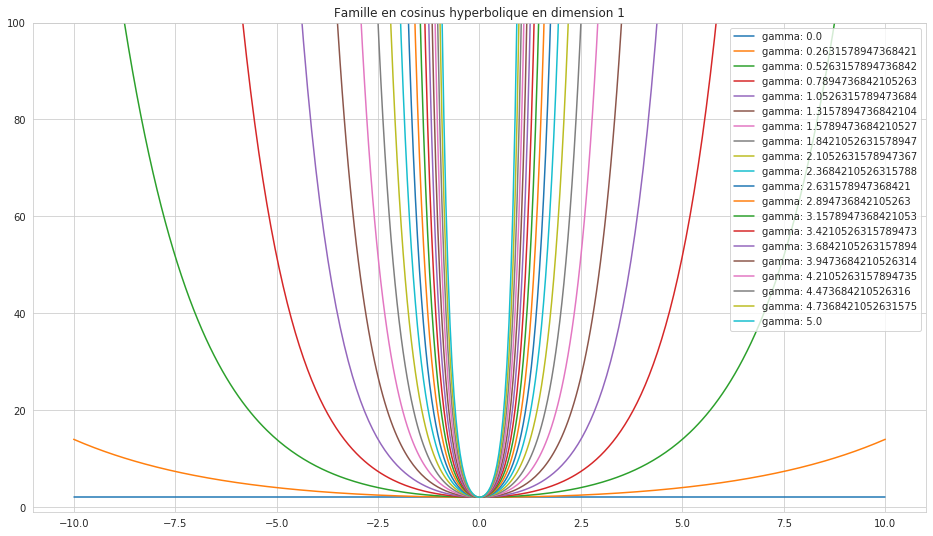

In [10]:
fig, ax = plt.subplots(figsize=(16, 9))
x = np.linspace(-10, 10, 400)
ax.set_ylim(-1, 100)
params = np.linspace(0, 5, 20)
for gamma in params:
    ax.plot(x, exp_I.value(x, gamma), label="gamma: {}".format(gamma))
ax.set_title("Famille en cosinus hyperbolique en dimension 1")
ax.legend()

In [11]:
multi_sinks_d = {
    "name": "multi_sinks_1",
    "dim" : 1,
    "nb_params" : 1,
    "convex" : False ,
    "value" : (lambda x, gamma: 20*np.cos(x**2) + (gamma * x**2)),
    "grad"  : (lambda x, gamma: -40*x*np.sin(x**2) + 2*gamma*x),
    "hess"  : (lambda x, gamma: -40*np.sin(x**2) - 80*x**2*np.cos(x**2) + 2*gamma),
    "HCN"   : (lambda x, gamma: 1 )  
}

multi_sinks = test_family(**multi_sinks_d)

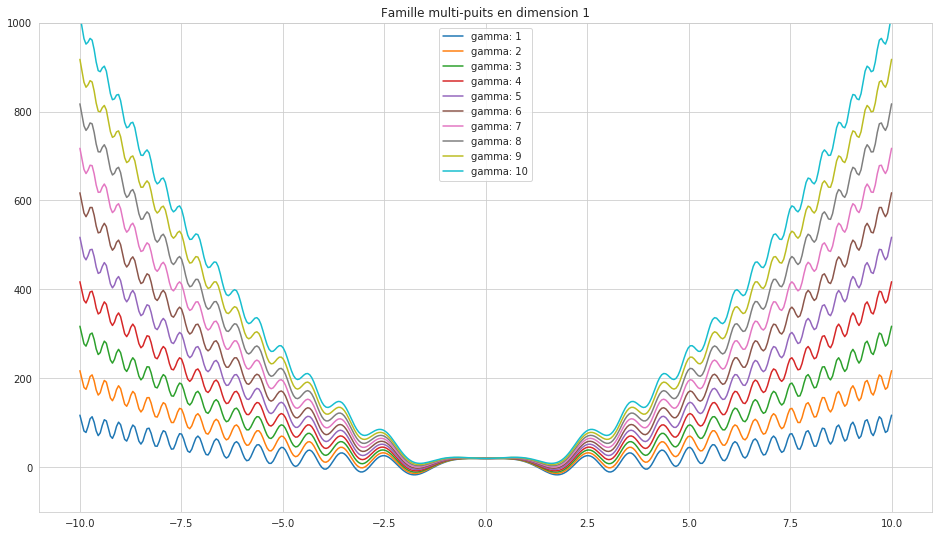

In [12]:
fig, ax = plt.subplots(figsize=(16, 9))
x = np.linspace(-10, 10, 400)
ax.set_ylim(-100, 1000)
for gamma in range(1, 11, 1):
    ax.plot(x, multi_sinks.value(x, gamma), label="gamma: {}".format(gamma))
ax.set_title("Famille multi-puits en dimension 1")
ax.legend()

2. Faire de même avec des fonctions sur $\mathbb{R}^2$.

In [13]:
quad_II_d = {
    "name": "quadric_2",
    "dim" : 2,
    "nb_params" : 1,
    "convex" : True ,
    "value" : (lambda x, gamma: x[:, 0]**2 + gamma*x[:, 1]**2),
    "grad"  : (lambda x, gamma: np.array([2*x[:, 0], 2*gamma*x[:, 1]]).reshape(1, -1)),
    "hess"  : (lambda x, gamma: np.diag([2, 2*gamma])),
    "HCN"   : (lambda x, gamma: gamma)
}

quad_II = test_family(**quad_II_d)

In [14]:
quad_II_d["grad"](np.array([[5, 5]]), 1)

array([[10, 10]])

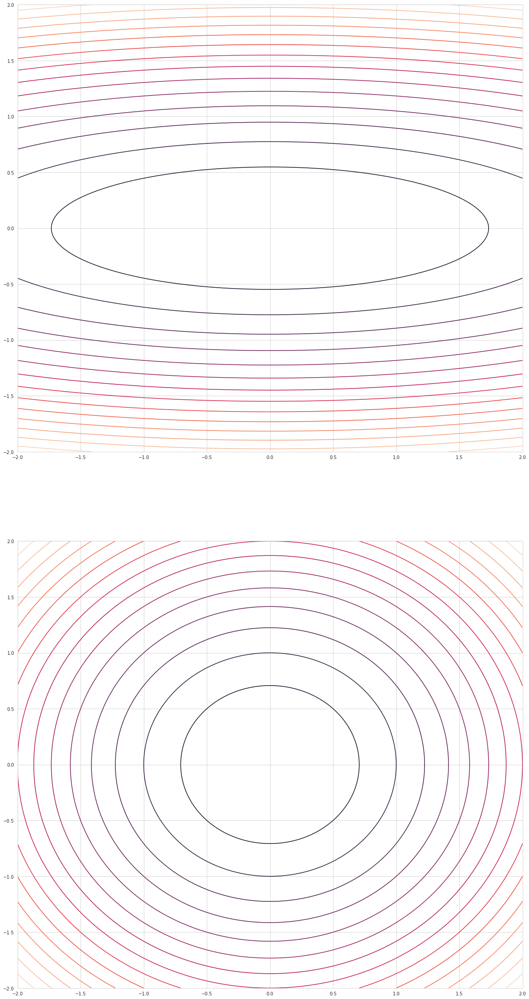

In [15]:
nb_pts, x_mi, x_ma, y_mi, y_ma = 200, -2, 2, -2, 2
fig, ax = plt.subplots(2, 1, figsize=(20, 40))
x, y = np.linspace(x_mi, x_ma, nb_pts), np.linspace(x_mi, x_ma, nb_pts)
X, Y = np.meshgrid(x, y)
## Reshaping X, Y for proper evaluation by input function
x_y = np.vstack([X.reshape(1, -1), Y.reshape(1, -1)]).reshape(1, 2, -1)
for i in [0, 1]:
    ax[i].set_xlim(x_mi, x_ma)
    ax[i].set_ylim(y_mi, y_ma)
ax[0].contour(X, Y, quad_II.value(x_y, 10).reshape(nb_pts, -1), 15)
ax[1].contour(X, Y, quad_II.value(x_y, 1).reshape(nb_pts, -1), 15)

3. Construire des familles de fonctions tests de dimensions de plus en plus grandes en fonction du paramètre. 

In [65]:
from math import sqrt

wave_II_d = {
    "name": "wave_2",
    "dim" : 2,
    "nb_params" : 1,
    "convex" : False ,
    "value" : (lambda x, gamma: gamma*np.cos(x[:, 0])*np.cos(x[:, 1])),
    "grad"  : (lambda x, gamma: np.array([-gamma*np.sin(x[:, 0])*np.cos(x[:, 1]), -gamma*np.sin(x[:, 1])*np.cos(x[:, 0])]).reshape(1, -1)),
    "hess"  : (lambda x, gamma: np.array([[-gamma*np.cos(x[:, 0])*np.cos(x[:, 1]), gamma*np.sin(x[:, 0])*np.sin(x[:, 1])], [gamma*np.sin(x[:, 0])*np.sin(x[:, 1]), -gamma*np.cos(x[:, 0])*np.cos(x[:, 1])]])),
    "HCN"   : (lambda x, gamma: max(-gamma*np.cos(x[:, 0] - x[:, 1]), -gamma*np.cos(x[:, 0] + x[:, 1])) / min(-gamma*np.cos(x[:, 0] - x[:, 1]), -gamma*np.cos(x[:, 0] + x[:, 1])))
}

wave_II = test_family(**wave_II_d)

cubic_II_d = { 
    "name": "cubic_2",
    "dim" : 2,
    "nb_params" : 1,
    "convex" : False,
    "value" : (lambda x, gamma: x[:, 0]**3 + gamma*x[:, 0]**2 + x[:, 0] + x[:, 1]**3 + gamma*x[:, 1]**2 + x[:, 1] + x[:, 0]**2*x[:, 1] + x[:, 1]**2*x[:, 0] + x[:, 0]*x[:, 1] + 1),
    "grad"  : (lambda x, gamma: np.array([3*x[:, 0]**2 + 2*gamma*x[:, 0] + 1 + 2*x[:, 1]*x[:, 0] + x[:, 1]**2 + x[:, 1], 3*x[:, 1]**2 + 2*gamma*x[:, 1] + 1 + x[:, 0]**2 + 2*x[:, 0]*x[:, 1] + x[:, 0]]).reshape(1, -1)),
    "hess"  : (lambda x, gamma: np.array([[6*x[:, 0] + 2*gamma + 2*x[:, 1], 2*x[:, 0] + 2*x[:, 1] + 1], [2*x[:, 0] + 2*x[:, 1] + 1, 6*x[:, 1] + 2*gamma + 2*x[:, 0]]])),
    "HCN"   : (lambda x, gamma: (2*gamma + 4*x[:, 0] + 4*x[:, 1] + sqrt(8*x[:, 0]**2 + 4*x[:, 0] + 8*x[:, 1]**2 + 4*x[:, 1] + 1)) / (2*gamma + 4*x[:, 0] + 4*x[:, 1] - sqrt(8*x[:, 0]**2 + 4*x[:, 0] + 8*x[:, 1]**2 + 4*x[:, 1] + 1)) ) 
}

cubic_II = test_family(**cubic_II_d)

quad_III_d = {
    "name": "quadric_3",
    "dim" : 3,
    "nb_params" : 1,
    "convex" : True ,
    "value" : (lambda x, gamma: x[:, 0]**2 + gamma*x[:, 1]**2 + x[:, 2]**2),
    "grad"  : (lambda x, gamma: np.array([2*x[:, 0], 2*gamma*x[:, 1], 2*x[:, 2]]).reshape(1, -1)),
    "hess"  : (lambda x, gamma: np.diag([2, 2*gamma, 2])),
    "HCN"   : (lambda x, gamma: gamma)
}

quad_III = test_family(**quad_III_d)

quad_IIII_d = {
    "name": "quadric_4",
    "dim" : 4,
    "nb_params" : 1,
    "convex" : True ,
    "value" : (lambda x, gamma: (x[:, 0]**2 / 2) + (gamma*x[:, 1]**2) + (x[:, 2]**2 / 2) + (x[:, 3]**2 / 2)),
    "grad"  : (lambda x, gamma: np.array([x[:, 0], 2*gamma*x[:, 1], x[:, 2], x[:, 3]]).reshape(1, -1)),
    "hess"  : (lambda x, gamma: np.diag([1, 2*gamma, 1, 1])),
    "HCN"   : (lambda x, gamma: 2*gamma)
}

quad_IIII = test_family(**quad_IIII_d)

def value_function_quad_100_d(x, gamma):
    x_squared = np.square(x)
    x_squared[:, 1]*=gamma
    return np.sum(x_squared)

def value_function_quad_100_d_gradient(x, gamma):
    g = x * 2
    g[:, 1]*=gamma
    return g.reshape(1, -1)

def value_function_quad_100_d_hessian(x, gamma):
    d = 2 * np.identity(100)
    d[1, 1]*=gamma
    return d
    

quad_100_d = {
    "name": "quadric_100",
    "dim" : 100,
    "nb_params" : 1,
    "convex" : True ,
    "value" : (lambda x, gamma: value_function_quad_100_d(x, gamma)),
    "grad"  : (lambda x, gamma: value_function_quad_100_d_gradient(x, gamma)),
    "hess"  : (lambda x, gamma: value_function_quad_100_d_hessian(x, gamma)),
    "HCN"   : (lambda x, gamma: gamma)
}

quad_100 = test_family(**quad_100_d)

exp_II_d = {
    "name": "exp_2",
    "dim" : 2,
    "nb_params" : 1,
    "convex" : True ,
    "value" : (lambda x, gamma: (np.exp(gamma*x[:, 0]) + np.exp(-gamma*x[:, 0]))*(np.exp(gamma*x[:, 1]) + np.exp(-gamma*x[:, 1]))),
    "grad"  : (lambda x, gamma: np.array([(np.exp(gamma*x[:, 1])+np.exp(-gamma*x[:, 1]))*(gamma*np.exp(gamma*x[:, 0])-gamma*np.exp(-gamma*x[:, 0])), (np.exp(gamma*x[:, 0])+np.exp(-gamma*x[:, 0]))*(gamma*np.exp(gamma*x[:, 1])-gamma*np.exp(-gamma*x[:, 1]))]).reshape(1, -1)),
    "hess"  : (lambda x, gamma: np.array([[(np.exp(gamma*x[:, 1])+np.exp(-gamma*x[:, 1]))*(gamma**2*np.exp(gamma*x[:, 0])+gamma**2*np.exp(-gamma*x[:, 0])), (gamma*np.exp(gamma*x[:, 0])-gamma*np.exp(-gamma*x[:, 0]))*(gamma*np.exp(gamma*x[:, 1])-gamma*np.exp(-gamma*x[:, 1]))], [(gamma*np.exp(gamma*x[:, 0])-gamma*np.exp(-gamma*x[:, 0]))*(gamma*np.exp(gamma*x[:, 1])-gamma*np.exp(-gamma*x[:, 1])), (np.exp(gamma*x[:, 0])+np.exp(-gamma*x[:, 0]))*(gamma**2*np.exp(gamma*x[:, 1])+gamma**2*np.exp(-gamma*x[:, 1]))]])),
    "HCN"   : (lambda x, gamma: max((2*gamma**2*np.exp(2*gamma*x[:, 1]) + 2*gamma**2*np.exp(2*gamma*x[:, 0])) / (np.exp(x[:, 0]*gamma + x[:, 1]*gamma)), (2*gamma**2+2*gamma**2*np.exp(2*x[:, 0]*gamma+2*x[:, 1]*gamma)) / (np.exp(x[:, 0]*gamma + x[:, 1]*gamma))) / min((2*gamma**2*np.exp(2*gamma*x[:, 1]) + 2*gamma**2*np.exp(2*gamma*x[:, 0])) / (np.exp(x[:, 0]*gamma + x[:, 1]*gamma)), (2*gamma**2+2*gamma**2*np.exp(2*x[:, 0]*gamma+2*x[:, 1]*gamma)) / (np.exp(x[:, 0]*gamma + x[:, 1]*gamma))))    
}

exp_II = test_family(**exp_II_d)

newton_II_d = {
    "name": "newton_2",
    "dim" : 2,
    "nb_params" : 1,
    "convex" : True ,
    "value" : (lambda x, gamma: gamma * x[:, 0]**2 + gamma * x[:, 1]**2 + np.exp(x[:, 1] + x[:, 0])),
    "grad"  : (lambda x, gamma: np.array([2*gamma*x[:, 0] + np.exp(x[:, 1] + x[:, 0]), 2*gamma*x[:, 1] + np.exp(x[:, 1] + x[:, 0])]).reshape(1, -1)),
    "hess"  : (lambda x, gamma: np.array([2*gamma + np.exp(x[:, 1] + x[:, 0]), np.exp(x[:, 1] + x[:, 0]), np.exp(x[:, 1] + x[:, 0]), 2*gamma + np.exp(x[:, 1] + x[:, 0])]).reshape(2, 2)),
    "HCN"   : (lambda x, gamma: 1 + (np.exp(x[:, 0] + x[:, 1]) / gamma))
}

newton_comparison_function = test_family(**newton_II_d)

newton_fail_I_d = {
    "name": "newton_fail",
    "dim" : 1,
    "nb_params" : 1,
    "convex" : True ,
    "value" : (lambda x, gamma: (x[:, 0]**4 / 4) - x[:, 0]**2 + 2*gamma*x[:, 0]),
    "grad"  : (lambda x, gamma: x[:, 0]**3 - 2*x[:, 0] + 2*gamma),
    "hess"  : (lambda x, gamma: 3*x[:, 0]**2 - 2),
    "HCN"   : (lambda x, gamma: 1)
}

newton_fail = test_family(**newton_fail_I_d)

newton_fail_second_d = {
    "name": "newton_fail_second",
    "dim" : 1,
    "nb_params" : 1,
    "convex" : True ,
    "value" : (lambda x, gamma: gamma * x[:, 0] - (x[:, 0]**3 / 3)),
    "grad"  : (lambda x, gamma: gamma - x[:, 0]**2),
    "hess"  : (lambda x, gamma: -2*x[:, 0]),
    "HCN"   : (lambda x, gamma: 1)
}

newton_fail_second = test_family(**newton_fail_second_d)

local_minimum_II_d = {
    "name": "local_minimum",
    "dim" : 2,
    "nb_params" : 1,
    "convex" : True ,
    "value" : (lambda x, gamma: -gamma*np.exp(-((x[:, 0]-1)**2 + x[:, 1]**2) / 0.2) - 2*gamma*np.exp(-((x[:, 0]+1)**2 + x[:, 1]**2)/0.2) + x[:, 0]**2 + x[:, 1]**2),
    "grad"  : (lambda x, gamma: np.array([gamma*10*(x[:, 0]-1)*np.exp(-((x[:, 0]-1)**2 + x[:, 1]**2)/0.2) + 20*gamma*(x[:, 0]+1)*np.exp(-((x[:, 0]+1)**2 + x[:, 1]**2)/0.2) + 2*x[:, 0], gamma*10*x[:, 1]*np.exp(-((x[:, 0] - 1)**2 + x[:, 1]**2) / 0.2) + 20*gamma*x[:, 1]*np.exp(-((x[:, 0]+1)**2 + x[:, 1]**2)/0.2) + 2*x[:, 1]]).reshape(1, -1)),
    "hess"  : (lambda x, gamma: np.array([[10*gamma*np.exp(-((x[:, 0]-1)**2 + x[:, 1]**2) / 0.2) - 100*gamma*(x[:, 0]-1)**2*np.exp(-((x[:, 0]-1)**2 + x[:, 1]**2) / 0.2) + 20*gamma*np.exp(-((x[:, 0]+1)**2 + x[:, 1]**2)/0.2) - 200*gamma*(x[:, 0]+1)**2*np.exp(-((x[:, 0]+1)**2 + x[:, 1]**2)/0.2) + 2, -100*gamma*(x[:, 0]-1)*x[:, 1]*np.exp(-((x[:, 0]-1)**2 + x[:, 1]**2) / 0.2) - 200*gamma*(x[:, 0]+1)*x[:, 1]*np.exp(-((x[:, 0]+1)**2 + x[:, 1]**2)/0.2)], [-100*gamma*(x[:, 0]-1)*x[:, 1]*np.exp(-((x[:, 0]-1)**2 + x[:, 1]**2) / 0.2) - 200*gamma*(x[:, 0]+1)*x[:, 1]*np.exp(-((x[:, 0]+1)**2 + x[:, 1]**2)/0.2), 10*gamma*np.exp(-((x[:, 0]-1)**2 + x[:, 1]**2) / 0.2) - 100*gamma*x[:, 1]**2*np.exp(-((x[:, 0]-1)**2 + x[:, 1]**2) / 0.2) + 20*gamma*np.exp(-((x[:, 0]+1)**2 + x[:, 1]**2)/0.2) - 200*gamma*x[:, 1]**2*np.exp(-((x[:, 0]+1)**2 + x[:, 1]**2)/0.2) + 2]])),
    "HCN"   : (lambda x, gamma: 1)
}

local_minimum = test_family(**local_minimum_II_d)

saddle_point_second_d = {
    "name": "saddle_point_II",
    "dim" : 2,
    "nb_params" : 1,
    "convex" : False ,
    "value" : (lambda x, gamma: np.sin(x[:, 0]) + gamma*x[:, 1]**2),
    "grad"  : (lambda x, gamma: np.array([np.cos(x[:, 0]), 2*gamma*x[:, 1]]).reshape(1, -1)),
    "hess"  : (lambda x, gamma: np.diag([-np.sin(x[:, 0]), 2*gamma])),
    "HCN"   : (lambda x, gamma: max(-np.sin(x[:, 0]), 2*gamma) / min(-np.sin(x[:, 0]), 2*gamma))
}

saddle_point = test_family(**saddle_point_second_d)

elliptic_bowl_second_d = {
    "name": "elliptic_bowl_II",
    "dim" : 2,
    "nb_params" : 1,
    "convex" : True ,
    "value" : (lambda x, gamma: -np.exp(-(x[:, 0]**2 + 5*x[:, 1]**2)) + gamma*x[:, 0]**2 + x[:, 1]**2),
    "grad"  : (lambda x, gamma: np.array([2*x[:, 0]*np.exp(-(x[:, 0]**2 + 5*x[:, 1]**2)) + 2*gamma*x[:, 0], 10*x[:, 1]*np.exp(-(x[:, 0]**2 + 5*x[:, 1]**2)) + 2*x[:, 1]]).reshape(1, -1)),
    "hess"  : (lambda x, gamma: np.array([[-4*x[:, 0]**2*np.exp(-(x[:, 0]**2 + 5*x[:, 1]**2)) + 2*np.exp(-(x[:, 0]**2 + 5*x[:, 1]**2)) + 2*gamma, -20*x[:, 0]*x[:, 1]*np.exp(-(x[:, 0]**2 + 5*x[:, 1]**2))], [-20*x[:, 0]*x[:, 1]*np.exp(-(x[:, 0]**2 + 5*x[:, 1]**2)), -100*x[:, 1]**2*np.exp(-(x[:, 0]**2 + 5*x[:, 1]**2)) + 10*np.exp(-(x[:, 0]**2 + 5*x[:, 1]**2)) + 2]])),
    "HCN"   : (lambda x, gamma: 1)
}

elliptic_bowl = test_family(**elliptic_bowl_second_d)

hills_second_d = {
    "name": "hills_II",
    "dim" : 2,
    "nb_params" : 1,
    "convex" : False ,
    "value" : (lambda x, gamma: gamma*np.exp(-((x[:, 0]-1)**2 + x[:, 1]**2) / 0.2) + 2*gamma*np.exp(-((x[:, 0]+1)**2 + x[:, 1]**2)/0.2) - gamma*np.exp(-((x[:, 0]-1)**2 + (x[:, 1]+1)**2)/0.2) + x[:, 0]**2 + x[:, 1]**2),
    "grad"  : (lambda x, gamma: np.array([-10*gamma*(x[:, 0]-1)*np.exp(-((x[:, 0]-1)**2 + x[:, 1]**2) / 0.2) - 20*gamma*(x[:, 0]+1)*np.exp(-((x[:, 0]+1)**2 + x[:, 1]**2)/0.2) + 10*gamma*(x[:, 0]-1)*np.exp(-((x[:, 0]-1)**2 + (x[:, 1]+1)**2) / 0.2) + 2*x[:, 0], -10*gamma*x[:, 1]*np.exp(-((x[:, 0]-1)**2 + x[:, 1]**2) / 0.2) -20*gamma*x[:, 1]*np.exp(-((x[:, 0]+1)**2 + x[:, 1]**2)/0.2) + 10*gamma*(x[:, 1]+1)*np.exp(-((x[:, 0]-1)**2 + (x[:, 1]+1)**2) / 0.2) +2*x[:, 1]]).reshape(1, -1)),
    "hess"  : (lambda x, gamma: np.array([[-10*gamma*np.exp(-((x[:, 0]-1)**2 + x[:, 1]**2) / 0.2) + 100*gamma*(x[:, 0]-1)**2*np.exp(-((x[:, 0]-1)**2 + x[:, 1]**2) / 0.2) - 20*gamma*np.exp(-((x[:, 0]+1)**2 + x[:, 1]**2)/0.2) + 200*gamma*(x[:, 0]+1)**2*np.exp(-((x[:, 0]+1)**2 + x[:, 1]**2)/0.2) + 10*gamma*np.exp(-((x[:, 0]-1)**2 + (x[:, 1]+1)**2)/0.2) - 100*gamma*(x[:, 0]-1)**2*np.exp(-((x[:, 0]-1)**2 + (x[:, 1]+1)**2)/0.2) + 2, 100*gamma*x[:, 1]*(x[:, 0]-1)*np.exp(-((x[:, 0]-1)**2 + x[:, 1]**2) / 0.2) + 200*gamma*x[:, 1]*(x[:, 0]+1)*np.exp(-((x[:, 0]+1)**2 + x[:, 1]**2)/0.2) - 100*gamma*(x[:, 1]+1)*(x[:, 0]-1)*np.exp(-((x[:, 0]-1)**2 + (x[:, 1]+1)**2)/0.2)], [100*gamma*x[:, 1]*(x[:, 0]-1)*np.exp(-((x[:, 0]-1)**2 + x[:, 1]**2) / 0.2) + 200*gamma*x[:, 1]*(x[:, 0]+1)*np.exp(-((x[:, 0]+1)**2 + x[:, 1]**2)/0.2) - 100*gamma*(x[:, 1]+1)*(x[:, 0]-1)*np.exp(-((x[:, 0]-1)**2 + (x[:, 1]+1)**2)/0.2), -10*gamma*np.exp(-((x[:, 0]-1)**2 + x[:, 1]**2) / 0.2) + 100*gamma*x[:, 1]**2*np.exp(-((x[:, 0]-1)**2 + x[:, 1]**2) / 0.2) - 20*gamma*np.exp(-((x[:, 0]+1)**2 + x[:, 1]**2)/0.2) + 200*gamma*x[:, 1]**2*np.exp(-((x[:, 0]+1)**2 + x[:, 1]**2)/0.2) + 10*gamma*np.exp(-((x[:, 0]-1)**2 + (x[:, 1]+1)**2)/0.2) - 100*gamma*(x[:, 1]+1)**2*np.exp(-((x[:, 0]-1)**2 + (x[:, 1]+1)**2)/0.2) + 2]])),
    "HCN"   : (lambda x, gamma: 1)
}

hills = test_family(**hills_second_d)

def plateau_value(x, gamma):
    r = np.sqrt(x[:, 0]**2 + x[:, 1]**2) + 0.01
    return (-np.sin(r)/r) + 0.01*r**2

def plateau_gradient(x, gamma):
    u = np.sqrt(x[:, 0]**2 + x[:, 1]**2)
    r = u + 0.01
    return np.array([(0.02*x[:, 0]*r)/u + (x[:, 0]*np.sin(r))/(u*r**2) - (x[:, 0]*np.cos(r))/(u*r), (0.02*x[:, 1]*r)/u + (x[:, 1]*np.sin(r))/(u*r**2) - (x[:, 1]*np.cos(r))/(u*r)]).reshape(1, -1)

def plateau_hesian(x, gamma):
    u = np.sqrt(x[:, 0]**2 + x[:, 1]**2)
    r = u + 0.01
    p = x[:, 0]**2 + x[:, 1]**2
    t = x[:, 0]*x[:, 1]
    return np.array([[-(0.02*x[:, 0]**2*r)/(p**(3/2)) + (0.02*x[:, 0]**2)/p + (0.02*r)/u + (x[:, 0]**2*np.sin(r))/(u*r) - (x[:, 0]**2*np.sin(r))/((p**(3/2))*(r**2)) - (2*x[:, 0]**2*np.sin(r))/(p*r**3) + (np.sin(r))/(u*r**2) + (x[:, 0]**2*np.cos(r))/(p**(3/2)*r) + (2*x[:, 0]**2*np.cos(r))/(p*r**2) - (np.cos(r))/(u*r), -(0.02*t*r)/(p**(3/2)) + (0.02*t)/(p) + (t*np.sin(r))/(p*r) - (t*np.sin(r))/((p**(3/2))*(r**2)) - (2*t*np.sin(r))/(p*r**3) + (t*np.cos(r))/(p**(3/2)*r) + (2*t*np.cos(r))/(p*r**2)], [-(0.02*t*r)/(p**(3/2)) + (0.02*t)/(p) + (t*np.sin(r))/(p*r) - (t*np.sin(r))/((p**(3/2))*(r**2)) - (2*t*np.sin(r))/(p*r**3) + (t*np.cos(r))/(p**(3/2)*r) + (2*t*np.cos(r))/(p*r**2), -(0.02*x[:, 1]**2*r)/(p**(3/2)) + (0.02*x[:, 1]**2)/p + (0.02*r)/u + (x[:, 1]**2*np.sin(r))/(u*r) - (x[:, 1]**2*np.sin(r))/((p**(3/2))*(r**2)) - (2*x[:, 1]**2*np.sin(r))/(p*r**3) + (np.sin(r))/(u*r**2) + (x[:, 1]**2*np.cos(r))/(p**(3/2)*r) + (2*x[:, 1]**2*np.cos(r))/(p*r**2) - (np.cos(r))/(u*r)]])

plateau_second_d = {
    "name": "plateau_II",
    "dim" : 2,
    "nb_params" : 1,
    "convex" : False ,
    "value" : (lambda x, gamma: plateau_value(x, gamma)),
    "grad"  : (lambda x, gamma: plateau_gradient(x, gamma)),
    "hess"  : (lambda x, gamma: plateau_hessian(x, gamma)),
    "HCN"   : (lambda x, gamma: 1)
}

plateau = test_family(**plateau_second_d)


4. Construire une `test_list` contenant la liste des familles de fonctions tests crées jusque là.

In [17]:
test_list = [quad_I, cubic_I, exp_I, multi_sinks, quad_II, quad_III, quad_IIII, exp_II, wave_II, cubic_II, newton_comparison_function, local_minimum, saddle_point, elliptic_bowl, hills, plateau]

## Différencier une fonction

Pour calculer le gradient d'une fonction on a déjà besoin de savoir calculer la dérivée d'une fonction réelle. On s'intéresse à cette question dans cette section. Le point central est le fait qu'approcher numériquement la dérivée d'une fonction réelle est *prone* aux erreurs numériques ; on est souvent dans une meilleure posture lorsque l'on a une expression explicite pour le gradient d'une fonction.

### L'approche naïve

On rappelle que pour une fonction numérique le nombre dérivée d'une fonction $f : \mathbb{R} \to \mathbb{R}$ en un point $x \in \mathbb{R}$ est donnée par la limite :

$$ f'(x) = \lim_{h \to 0} \frac{f(x+h)-f(x)}{h} $$

quand celle-ci existe. D'un point de vue numérique une assez petite valeur $h$ donne un quotient suffisamment proche du nombre dérivée que l'on cherche. Ainsi pour $h$ assez petit on approche $f'(x)$ par 

$$ f'(x) \simeq \frac{f(x + h) - f(x)}{h} .$$

L'erreur à l'approximation est en $o(1)$ en $0$. 

1. Coder une fonction `partial_` qui calcule la dérivée partielle d'une fonction à plusieurs variables en utilisant la démarche précédente.

In [18]:
def partial_(f, x, i=0, dx=1e-6):
    """Computes i-th partial derivative of f at point x.
    
    Args:
        f: objective function.
        x: point at which partial derivative is computed.
        i: coordinate along which derivative is computed.
        dx: slack for finite difference.
        
    Output:
        (float)

    """
    x = x.reshape(1, -1)
    h = np.zeros(x.shape)
    h[0, i] = dx
    return (f(x + h) - f(x)) / dx

2. Tester votre fonction sur un exmple dont vous connaissez la dérivée partielle et comparer vos résutlats.

In [19]:
partial_(lambda x: np.exp(x), np.array([100]))

array([[2.68811848e+43]])

In [20]:
np.exp(np.array([100]))

array([2.68811714e+43])

**La différence est *petite* ou *grande*?**

### Une démarche un peu moins naïve

On peut en réalité faire un peu mieux ; le nombre dérivée est également la limite 

$$ f'(x) = \lim_{h \to 0} \frac{f(x+h)-f(x-h)}{2h} $$.

On approche donc $f'(x)$ par 

$$f'(x) \simeq \frac{f(x+h)-f(x-h)}{2h}$$.

La différence avec la première approximation résulte de l'écriture du DL du numérateur de cette seconde écriture (en supposant $f$ deux fois différentiable:

$$f(x + h) - f(x - h) = (f(x) + hf'(x) + \frac{h^2}{2}f''(x) + o(h^2)) - (f(x) - hf'(x) + \frac{h^2}{2} f''(x) + o(h^2))$$

Et donc:

$$f(x + h) - f(x - h) = 2hf'(x) + o(h^2)$$.

On trouve que l'erreur d'approximation dans le second cas est désormais $o(h)$ ; ce qui est supposé être une meilleure approximation que dans le premier cas.

**Remarque : si l'on souhaite faire un calcul précis de l'erreur dans l'approximation de la dérivée de $f$ en un point on s'y prendrait pas tout à fait comme cela, nous ne donnons ici qu'une vague idée de la différence entre les deux démarches précédentes.**

1. Utiliser la démarche précédente pour approcher la dérivée partielle d'une fonction en un point. Cette fonction sera notée `partial`.

In [21]:
def partial(f, x, i=0, dx=1e-6):
    """Computes i-th partial derivative of f at point x.
    
    Args:
        f: objective function.
        x: point at which partial derivative is computed.
        i: coordinate along which derivative is computed.
        dx: slack for finite difference.
        
    Output:
        (float)

    """
    x = x.reshape(1, -1)
    h = np.zeros(x.shape)
    h[0, i] = dx
    return (f(x + h) - f(x - h)) / (2*dx)

2. Comparer `partial` à `partial_` et à l'expression exacte de la dérivée partielle d'une fonction de votre choix. 

In [22]:
partial(lambda x: np.exp(x), np.array([100]))

array([[2.68811713e+43]])

In [23]:
np.exp(np.array([100]))

array([2.68811714e+43])

Il est possible de raffiner d'avantage l'estimation de la dérivée d'une fonction en un point. On se contente de ces deux premières approches simples. Pour plus de détail vous pouvez vous référer au cours d'Analyse numérique de J-P. Demailly.

4. Effectuer des tests plus larges sur les divergences des différents schémas d'approximation précédents.

In [24]:
print(partial(lambda x: np.log(x), np.array([0.5])))
print(partial_(lambda x: np.log(x), np.array([0.5])))
print(1/0.5)

[[2.]]
[[1.999998]]
2.0


In [25]:
print(partial(lambda x: x[:, 0]**2 + x[:, 1]**2, np.array([3, 4]), i=0))
print(partial_(lambda x: x[:, 0]**2 + x[:, 1]**2, np.array([3, 4]), i=0))
print(2*3)

[6.]
[6.000001]
6


In [26]:
print(partial(lambda x: np.sin(x), np.array([3])))
print(partial_(lambda x: np.sin(x), np.array([3])))
print(np.cos(3))

[[-0.9899925]]
[[-0.98999257]]
-0.9899924966004454


### Le calcul du gradient

On sait déjà par la démarche précédente que l'approximation numérique de la dérivée partielle d'une fonction en un point sera difficilement meilleure qu'une expression exacte. Parfois on n'est pas en mesure de trouver facilement et à la main la dérivée partielle d'une fonction ; on se garde donc la possibilité de calculer numériquement le gradient d'une fonction.

- Écrire une fonction `gradient` qui renvoie le gradient d'une fonction en un point.

In [27]:
def gradient(f, x, dx=1e-6):
    """Computes gradient of f at point x.
    
    Args:
        f: objective function.
        x: point at which gradient is computed.
        dx: slack for finite difference of partial derivatives.
        
    Output:
        (ndarray) of size domain of f.
        
    """
    x = x.reshape(1, -1)
    dim = x.shape[1]
    return np.array([partial(f, x, i, dx) for i in range(dim)]).reshape(1, -1)

In [28]:
gradient(lambda x: x[0, 0]**5 + x[0, 1]*2, np.array([1, 10]))

array([[5., 2.]])

## La classe `GD`

La classe correspond à l'interface par laquelle on va implémenter et comparer les différentes variantes des descentes de gradients. L'objectif de cette section est de remplir les différents composants de calcul du principe qu'on a vu en cours. 

In [66]:
class GD():
    """Gradient Descent Object.
    
    Implements gradient descent aiming to compute optimal objective 
    value of convex functions and local optimal ones of none 
    convex functions.
    
    """    
    def __init__(self, ddir=None, rate=None, decay=None, tol=None, max_iter=None):
        """        
        Instantiates a GD object.
    
        Attributes:
        ddir: function computing descent direction.
        rate: function computing learning rate ; takes in
              - x (ndarray): current iterate
              - f (function): objective function
              - dir_x (ndarray) : descent direction
              - grad (function) : gradient function
              - nb_iter (int): number of iterations.
              - eta (float): hyper-parameter.
        decay: function computing decay.
        tol: slack tolerance.
        max_iter: upper bound on number of iterations.
    
        """
        self.ddir = ddir if ddir else (lambda x, f, grad, tol: - grad(x, f, tol))
        self.rate = rate if rate else (lambda x, f, dir_x, grad, nb_iter, eta : 0.01)
        self.decay = decay if decay else (lambda x, f, grad, tol: np.linalg.norm(grad(x, f, tol)))
        self.tol = tol if tol else 1e-6
        self.max_iter = max_iter if max_iter else 1000
    
    def __call__(self, x, f, grad, verbose=False):
        """Calling gradient descent object with specific starting point and optimal function.
        
        Args:
            x: initial starting point for descent.
            f: objective function of optimisation problem.
            grad: function outputing gradient value of function f at a given point.
        
        Output:
            (float) sub-optimal value up to tolerance if execution is proper.
            (ndarray) list of gradient descent iterates.
            (ndarray) list of graidents of iterates.
            (int) number of iterations.
            
        """
        x = x.reshape(1, -1)
        eta = 0
        n_iter = 0

        dir_x = self.ddir(x, f, grad, self.tol)
        rate_ = self.rate(x, f, dir_x, grad, n_iter, eta)
        delta_x = rate_ * dir_x
        iters, iters_dir = x, delta_x
        decay_x = self.decay(x, f, grad, self.tol)
        while decay_x > self.tol and n_iter < self.max_iter:
            ## Deciding on direction
            dir_x = self.ddir(x, f, grad, self.tol)
            rate_ = self.rate(x, f, dir_x, grad, n_iter, eta)
            delta_x =  rate_ * dir_x
            
            ## Updating iterate
            x = x + delta_x

            # Storing iterates
            iters = np.vstack([iters, x])

            ## Storing directions
            iters_dir = np.vstack([iters_dir, delta_x])
            
            ## Computing decay
            decay_x = self.decay(x, f, grad, self.tol)
            
            ## Updating iteration number
            n_iter += 1
            
        if decay_x > self.tol:
            warnings.warn("Decay didn't get under tolerance rate.", RuntimeWarning)
        
        if verbose:
            msg = " Iteration nu. = {}\n approx. = {}\n ob value = {}\n and decay = {}."
            print(msg.format(n_iter, x.flatten(), f(x), decay_x))
        
        return (x, iters, iters_dir, n_iter) 

    def momentum(self, x, f, grad, rate, alpha, verbose=False):
        x = x.reshape(1, -1)
        eta = 0
        n_iter = 0

        delta_x = - rate * grad(x, f, self.tol)
        iters, iters_dir = x, delta_x
        
        decay_x = self.decay(x, f, grad, self.tol)
        while decay_x > self.tol and n_iter < self.max_iter:
            delta_x =  alpha * delta_x - rate * grad(x, f, self.tol)
            
            ## Updating iterate
            x = x + delta_x

            # Storing iterates
            iters = np.vstack([iters, x])
            
            ## Storing directions
            iters_dir = np.vstack([iters_dir, delta_x])
            
            ## Computing decay
            decay_x = self.decay(x, f, grad, self.tol)
            
            ## Updating iteration number
            n_iter += 1
            
        if decay_x > self.tol:
            warnings.warn("Decay didn't get under tolerance rate.", RuntimeWarning)
        
        if verbose:
            msg = " Iteration nu. = {}\n approx. = {}\n ob value = {}\n and decay = {}."
            print(msg.format(n_iter, x.flatten(), f(x), decay_x))
        
        return (x, iters, iters_dir, n_iter)

    def nesterov(self, x, f, grad, rate, alpha, verbose=False):
        x = x.reshape(1, -1)
        eta = 0
        n_iter = 0

        delta_x = -rate * grad(x, f, self.tol)
        iters, iters_dir = x, delta_x
        
        decay_x = self.decay(x, f, grad, self.tol)
        while decay_x > self.tol and n_iter < self.max_iter:
            delta_x =  alpha * delta_x - rate * grad(x + alpha * delta_x, f, self.tol)
            
            ## Updating iterate
            x = x + delta_x

            # Storing iterates
            iters = np.vstack([iters, x])
            
            ## Storing directions
            iters_dir = np.vstack([iters_dir, delta_x])
            
            ## Computing decay
            decay_x = self.decay(x, f, grad, self.tol)
            
            ## Updating iteration number
            n_iter += 1
            
        if decay_x > self.tol:
            warnings.warn("Decay didn't get under tolerance rate.", RuntimeWarning)
        
        if verbose:
            msg = " Iteration nu. = {}\n approx. = {}\n ob value = {}\n and decay = {}."
            print(msg.format(n_iter, x.flatten(), f(x), decay_x))
        
        return (x, iters, iters_dir, n_iter)

    def adam(self, x, f, grad, rate, beta1, beta2, epsilon, verbose=False):
        x = x.reshape(1, -1)
        eta = 0
        n_iter = 0

        m = 0
        #mt = m / (1 - beta1 ** (n_iter + 1))
        v = 0
        #vt = v / (1 - beta2**(n_iter + 1))

        #delta_x = - rate * mt / (np.sqrt(vt) + epsilon)
        #iters, iters_dir = x, delta_x
        iters, iters_dir = x, np.zeros(x.shape)
        decay_x = self.decay(x, f, grad, self.tol)
        while decay_x > self.tol and n_iter < self.max_iter:
            
            ## Updating iteration number
            n_iter += 1
            
            ## Updating iterate
            g = grad(x, f, self.tol)
            m = beta1 * m + (1 - beta1) * g
            v = beta2 * v + (1 - beta2) * np.power(g, 2)
            mt = m / (1 - np.power(beta1, n_iter))
            vt = v / (1 - np.power(beta2, n_iter))
            delta_x = -rate * mt / (np.sqrt(vt) + epsilon)
            x = x + delta_x
            
            # Storing iterates
            iters = np.vstack([iters, x])

            ## Storing directions
            iters_dir = np.vstack([iters_dir, delta_x])
            
            ## Computing decay
            decay_x = self.decay(x, f, grad, self.tol)
            
            
        if decay_x > self.tol:
            warnings.warn("Decay didn't get under tolerance rate.", RuntimeWarning)
        
        if verbose:
            msg = " Iteration nu. = {}\n approx. = {}\n ob value = {}\n and decay = {}."
            print(msg.format(n_iter, x.flatten(), f(x), decay_x))
        
        return (x, iters, iters_dir[1:, ...], n_iter)

    def newton(self, x, f, grad, hess, verbose=False):
        x = x.reshape(1, -1)
        eta = 0
        n_iter = 0

        delta_x = 0
        h = np.atleast_2d(hess(x, f, self.tol))
        g = np.atleast_2d(grad(x, f, self.tol))
        delta_x = - (np.linalg.inv(h) @ g.reshape((h.shape[1], -1))).reshape(x.shape)
        #if type(h) is np.ndarray and h.shape[0] > 1:
        #    delta_x = - np.linalg.inv(h).dot(g.reshape((h.shape[0], -1)))
        #else:
        #    delta_x = - (1 / h) * g

        iters, iters_dir = x, delta_x
        
        decay_x = self.decay(x, f, grad, self.tol)
        while decay_x > self.tol and n_iter < self.max_iter:
            
            # Storing iterates
            iters = np.vstack([iters, x])
            
            ## Updating iterate
            h = np.atleast_2d(hess(x, f, self.tol))
            g = np.atleast_2d(grad(x, f, self.tol))
            delta_x = - (np.linalg.inv(h) @ g.reshape((h.shape[1], -1))).reshape(x.shape)
            x = x + delta_x
            #if type(h) is np.ndarray and h.shape[0] > 1:
            #    x = x - (np.linalg.inv(h).dot(g.reshape((h.shape[1], -1)))).reshape((1, -1))
            #else:
            #    x = x - (1 / h) * g
            
            ## Storing directions
            iters_dir = np.vstack([iters_dir, delta_x])
            
            ## Computing decay
            decay_x = self.decay(x, f, grad, self.tol)
            
            ## Updating iteration number
            n_iter += 1
            
        if decay_x > self.tol:
            warnings.warn("Decay didn't get under tolerance rate.", RuntimeWarning)
        
        if verbose:
            msg = " Iteration nu. = {}\n approx. = {}\n ob value = {}\n and decay = {}."
            print(msg.format(n_iter, x.flatten(), f(x), decay_x))
        
        return (x, iters, iters_dir, n_iter)

### GD dans le cas d'un pas constant

Pour être en mesure de faire nos premiers tests d'utilisation de `GD` il nous faut encore se préoccuper des quelques hyperparamètres à fixer. On commence en un premier temps par tester la descente de gradient classique à pas constants.
 

1. Mettre les valeurs par défaut pour les attributs de `GD` de facon à obtenir une descente de gradients classique à pas constant et une condition d'arrêt donnée par le fait que le gradient en un point tombe en-deça d'un certain seuil de tolérance.

*Fait pour vous dans la GD, plus haut.*

2. Tester cette descente de gradient classique sur les différentes fonctions tests. Répertorier dans un tableau le point initial de chaque descente, le nombre d'itérations, le pas choisi et la valeur objectif obtenue.

Cherchons d'abord à manipuler la classe qu'on vient de construire

In [289]:
GD_default = GD()

In [290]:
op_pt, iters, iters_dir, n_iter = GD_default(np.array([10]), (lambda x : quad_I.value (x, 2)), 
                                             (lambda x, f, tol : quad_I.grad (x, 2)), True)

Iteration nu. = 430
 approx. = [-0.24999976]
 ob value = [[0.875]]
 and decay = 9.759196527570069e-07.


On peut visualiser dans lors de l'optimisation de problèmes de petites dimensions les itérés de la descente. `matplotlib` est là pour  vous aider dans votre démarche.

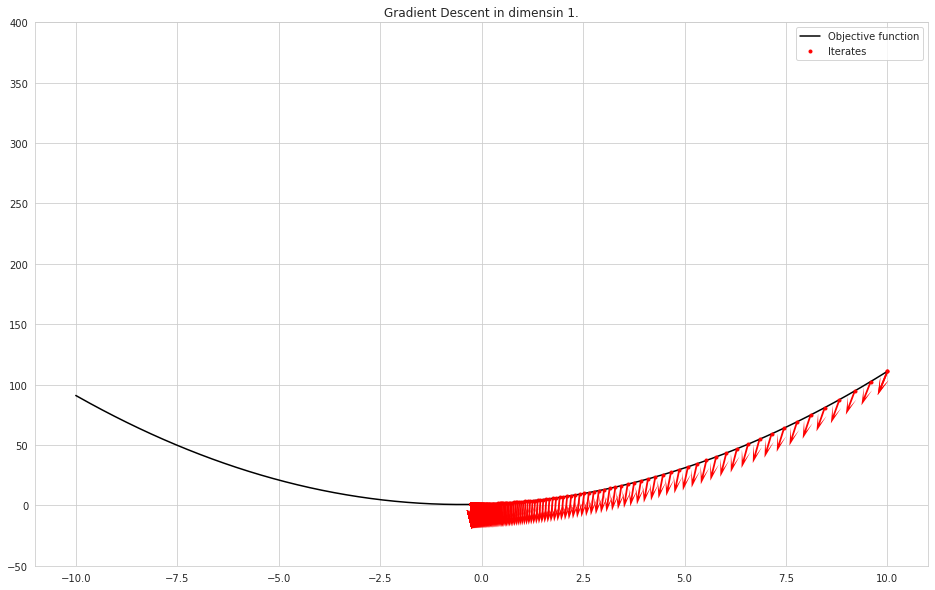

In [291]:
fig, ax = plt.subplots(figsize=(16, 10))
f = lambda x: quad_I.value (x, 1)
x = np.linspace(-10, 10, 400)
ax.set_ylim(-50, 400)
ax.plot(x, f(x), "k-", label="Objective function")
# reshaping iters for input
iters_reshape = iters.reshape(iters.shape[0], 1)
ax.plot(iters_reshape, f(iters_reshape), 'r.', label="Iterates")
ax.quiver(iters_reshape, f(iters_reshape), iters_dir, -1, 
          color='r', scale=None, width=0.002, headwidth=5, headlength=10)
ax.set_title("Gradient Descent in dimensin 1.")
ax.legend()

On se contente ici de travailler avec les fonctions tests de dimension $1$. **À vous de généraliser.**

In [292]:
test_list_d1 = [test_family for test_family in test_list if test_family.dim == 1]

In [293]:
init_pt = np.array([1])

In [294]:
gamma = 1

In [295]:
cst_rate = 0.02

In [69]:
import pandas as pd

In [297]:
GD_test_summary = pd.DataFrame(columns=["init_pt", "rate", "optimal_pt", "nb_iter"])
GD_list = {}
for t_function in test_list_d1:
    idt = 0
    GD_list[t_function.name] = GD(rate = lambda x, f, dir_x, grad, nb_iter, eta : cst_rate)
    opt_pt, _, _, n_iter = GD_list[t_function.name](init_pt, 
                                                    (lambda x: t_function.value (x, gamma)), 
                                                    (lambda x, f, tol : t_function.grad(x, gamma)))
    naming_format = "{}_{}".format(t_function.name, idt)
    GD_test_summary.loc[naming_format] = pd.Series({"init_pt": init_pt, 
                                                     "rate": GD_list[t_function.name].rate (*[None]*6), 
                                                     "optimal_pt": opt_pt, 
                                                     "nb_iter": n_iter})
    idt += 1
GD_test_summary

,init_pt,rate,optimal_pt,nb_iter
quadratic_1_0,[1],0.02,[[-0.4999995131865693]],366
cubic_1_0,[1],0.02,[[-inf]],111
exp_1_0,[1],0.02,[[4.87081969865494e-07]],354
multi_sinks_1_0,[1],0.02,[[0.484961982125542]],1000


3. Étudier pour un sous-ensemble de votre choix la relation entre le pas de la descente et le nombre d'itérations. Prendre soins de bien vérifier que vous avez convergence.

In [298]:
init_pt = np.array([10])

In [299]:
gammas = np.linspace(1, 10, 10)

In [300]:
cst_rates = np.linspace(0.01, 0.5, 200)

In [301]:
GD_rate_iter = pd.DataFrame(columns=["gamma", "rate", "optimal_pt", "optimal_val", "nb_iter"])
GD_list_ri = {}
for t_function in test_list_d1:
    for gamma in gammas:
        idt = 0
        for cst_rate in cst_rates:
            GD_list_ri[t_function.name] = GD(rate = lambda x, f, dir_x, grad, nb_iter, eta : cst_rate)
            opt_pt, _, _, n_iter = GD_list_ri[t_function.name](init_pt, 
                                                               (lambda x: t_function.value (x, gamma)), 
                                                               (lambda x, f, tol : t_function.grad(x, gamma)))
            naming_format = "{}_{}_{}".format(t_function.name, idt, gamma)
            GD_rate_iter.loc[naming_format] = pd.Series({"gamma": gamma, 
                                                         "rate": GD_list_ri[t_function.name].rate (*[None]*6), 
                                                         "optimal_pt": opt_pt,
                                                         "optimal_val": t_function.value(opt_pt, gamma),
                                                         "nb_iter": n_iter})
            idt += 1
GD_rate_iter

,gamma,rate,optimal_pt,optimal_val,nb_iter
quadratic_1_0_1.0,1.0,0.010000,[[-0.49999950459258535]],[[0.7500000000002454]],835
quadratic_1_1_1.0,1.0,0.012462,[[-0.49999950031085555]],[[0.7500000000002497]],668
quadratic_1_2_1.0,1.0,0.014925,[[-0.49999950950128774]],[[0.7500000000002406]],557
quadratic_1_3_1.0,1.0,0.017387,[[-0.4999995110595206]],[[0.750000000000239]],477
quadratic_1_4_1.0,1.0,0.019849,[[-0.499999515645947]],[[0.7500000000002346]],417
...,...,...,...,...,...
multi_sinks_1_195_10.0,10.0,0.490151,[[-8.277890109556768e+154]],[[nan]],151
multi_sinks_1_196_10.0,10.0,0.492613,[[1.879777945822611e+154]],[[nan]],155
multi_sinks_1_197_10.0,10.0,0.495075,[[-5.319723843816564e+154]],[[nan]],155
multi_sinks_1_198_10.0,10.0,0.497538,[[-1.4220218836495312e+154]],[[nan]],146


In [302]:
list_of_test_types = ["quadratic", "cubic", "exp", "multisinks"]

No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.


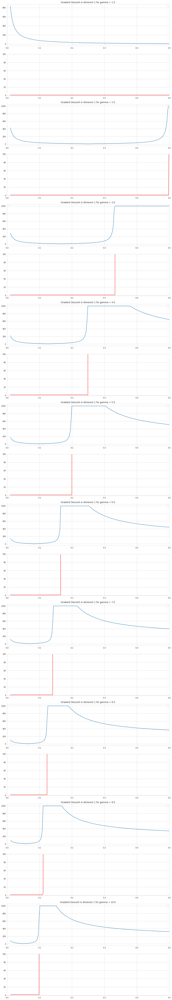

In [303]:
nb_figures = 2*len(gammas)
fig, ax = plt.subplots(nb_figures, 1, figsize=(16, 5*nb_figures))
selection = GD_rate_iter.index.str.contains("quadratic", regex=False)
i = 0
for gamma in gammas:
    df_selected = GD_rate_iter[(selection) & (GD_rate_iter["gamma"] == gamma)]
    ax[i].plot(df_selected["rate"], df_selected["nb_iter"])
    ax[i].set_xlim(0, 0.5)
    ax[i+1].plot(df_selected["rate"], df_selected["optimal_val"], "r")
    ax[i+1].set_ylim(-1, 100)
    ax[i+1].set_xlim(0, 0.5)
    ax[i].set_title("Gradient Descent in dimensin 1 for gamma = {}.".format(gamma))
    ax[i].legend()
    i += 2

4. Étudier la relation entre la vitesse de convergence et le point initial de votre descente dans le cas des fonctions numériques.

In [304]:
init_points = np.linspace(-10, 10, 20)
gammas = np.arange(1, 11)

On fixe un learning rate plus faible dans le cas de la fonction multi_sinks et de la fonction exp_I pour éviter l'overshoot et ainsi trouver le bon minimum local.

In [305]:
GD_rate_iter = pd.DataFrame(columns=["function_name", "init_point", "nb_iter", "optimal_point", "optimal_value", "gamma"])
GD_list_ri = {}
for t_function in test_list_d1:
    for gamma in gammas:
        for init_point in init_points:
            if t_function.name == 'multi_sinks_1' or t_function.name == 'exp_1':
                GD_list_ri[t_function.name] = GD(rate = lambda x, f, dir_x, grad, nb_iter, eta : 0.001)
            else:
                GD_list_ri[t_function.name] = GD(rate = lambda x, f, dir_x, grad, nb_iter, eta : 0.01)
            opt_pt, iters, iters_dir, n_iter = GD_list_ri[t_function.name](init_point, 
                                                                (lambda x: t_function.value (x, gamma)), 
                                                                (lambda x, f, tol : t_function.grad(x, gamma)))
            GD_rate_iter = GD_rate_iter.append({"function_name": t_function.name, "init_point": init_point, "nb_iter": n_iter, "optimal_point": opt_pt, "optimal_value": t_function.value(opt_pt, 1), "gamma": gamma}, ignore_index=True)
GD_rate_iter.set_index("function_name")
GD_rate_iter

,function_name,init_point,nb_iter,optimal_point,optimal_value,gamma
0,quadratic_1,-10.000000,830,[[-0.5000004958683966]],[[0.7500000000002458]],1
1,quadratic_1,-8.947368,824,[[-0.5000004977460317]],[[0.7500000000002478]],1
2,quadratic_1,-7.894737,818,[[-0.5000004918726104]],[[0.7500000000002419]],1
3,quadratic_1,-6.842105,810,[[-0.5000004958550684]],[[0.7500000000002458]],1
4,quadratic_1,-5.789474,801,[[-0.5000004960198888]],[[0.750000000000246]],1
...,...,...,...,...,...,...
795,multi_sinks_1,5.789474,1000,[[5.7685468617817]],[[27.56839601755478]],10
796,multi_sinks_1,6.842105,1000,[[6.348817146060804]],[[23.08403780752833]],10
797,multi_sinks_1,7.894737,1000,[[6.27207915711855]],[[37.95869933348444]],10
798,multi_sinks_1,8.947368,1000,[[6.344978679133377]],[[23.55090680453591]],10


No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles wi

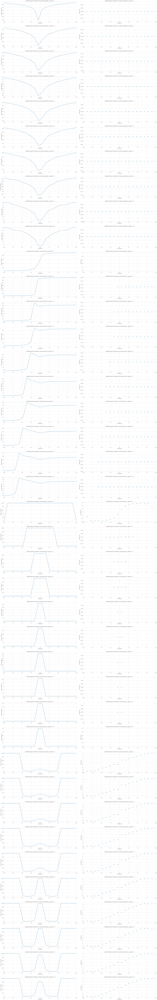

In [306]:
fig, ax = plt.subplots(len(test_list_d1) * len(gammas), 2, figsize=(32, 5*len(test_list_d1) * len(gammas)))
groups = GD_rate_iter.groupby("function_name")
for i, function in enumerate(test_list_d1):
    group = groups.get_group(function.name)
    for gamma_index, gamma in enumerate(gammas):
        group_gamma = group[group['gamma'] == gamma]
        x = group_gamma["init_point"].values
        y = group_gamma["nb_iter"].values
        ax[i * len(gammas) + gamma_index, 0].plot(x, y)
        ax[i * len(gammas) + gamma_index, 0].set_xlim(-10, 10)
        ax[i * len(gammas) + gamma_index, 0].set_title("Gradient Descent in dimensin 1 for function {}, gamma = {}.".format(function.name, gamma))
        ax[i * len(gammas) + gamma_index, 0].set_xlabel("starting point")
        ax[i * len(gammas) + gamma_index, 0].set_ylabel("number of iterations")
        ax[i * len(gammas) + gamma_index, 0].legend()
        ax[i * len(gammas) + gamma_index, 1].scatter(x, group_gamma['optimal_point'].values)
        ax[i * len(gammas) + gamma_index, 1].set_xlim(-10, 10)
        ax[i * len(gammas) + gamma_index, 1].set_title("Gradient Descent in dimensin 1 for function {}, gamma = {}.".format(function.name, gamma))
        ax[i * len(gammas) + gamma_index, 1].set_xlabel("starting point")
        ax[i * len(gammas) + gamma_index, 1].set_ylabel("optimal_point")
        ax[i * len(gammas) + gamma_index, 1].legend()
fig.tight_layout(pad=3.0)

Pour la fonction quadratic_1, la descente de gradient donne de bons résultats et on remarque que plus le point initial de la descente est proche du point solution, plus le nombre d'itérations requises pour converger vers le minimum est faible.

Pour la fonction cubic_1, pour gamma == 1, il n'y a pas de point critique donc il est logique qu'aucun point ne soit représenté sur le graphe de droite. Pour gamma == 2, un minimum existe pour x == -1/3 et cela est bien représenté sur le graphe de droite. Toutefois, on remarque que pour un point initial inférieur à -2/3, c'est à dire pour la portion concave de la courbe (calcul avec la derivée seconde), la descente de gradient ne parvient pas à trouver le minimum. L'analyse est similaire pour gamma >= 2.

Pour la fonction exp_1, Il existe normalement un minimum pour x = 0 et on remarque que pour gamma = 1, le minimum trouvé varie en fonction du point de départ de la descente choisi. Encore une fois, plus on choisit on point de départ proche de la solution, plus on trouve au final un minimum proche du véritable minimum. On remarque également qu'a partir de gamma = 2, plus on choisit un point de départ éloigné de la solution (zero), et moins la descente de gradient parvient à trouver un minimum proche de la solution. En particulier, on a du mal a trouver ue solution satisfaisante en moins de 1000 iterations (limite fixée). Cela s'explique par le choix du learning rate. En choisissant un learning rate trop grand, on a tendance a faire de l'overshoot et a rapidement itérer vers l'infinie ce qui interromp la descente. A l'inverse si on choisit on learning rate trop faible, on aura du mal a trouver une bonne solution en moins de 1000 iterations.

Pour la fonction multi_sinks, le résultat de la descente de gradient est conditionné par le choix du point de départ. En effet, la fonction disposant de multiples minimums locaux, le point de départ de la descente va determiner le 'creux' dans lequel on tombe.

### GD dans le cas de *backtracking*

Vous devriez avoir constatés que le choix du pas de descente dans le cas constant est crucial pour garantir la convergence de l'algorithme de descente. Dans cette section on s'intéresse à un calcul adaptatif du pas de descente qui permet de mieux garantir la convergence de notre algo. Le désavatage est le temps que prend désormais chaque itération pour s'exécuter.

1. Écrire une fonction `backtracking` qui permet de calculer le pas par *backtracking* à une itération donnée. Pour rappel le *backtracking* a deux hyper-paramètre $\alpha$ et $\beta$ respectivement mis par défaut à $0.01$ et $0.08$.

In [307]:
class backtracking():
    
    def __init__(self, alpha=0.01, beta=0.8, max_iter=100):
        self.alpha = alpha
        self.beta = beta
        self.max_iter = max_iter
        
    def __call__(self, x, f, dir_x, grad, n_iter, eta, tol=1e-6):
        n_while = 0
        t = 1
        x = x.reshape(1, -1)
        grad_f = grad(x, f, tol)
        while f(x + t * dir_x) > f(x) + self.alpha * t * grad_f.dot(dir_x.T) and n_while < self.max_iter:
            t = self.beta * t
            n_while += 1
        return t

2. Comparer la GD par backtracking aux tests effectués jusqu'à présent dans le cas d'une GD à pas constant (à vous de réfléchir à ce que vous voulez comparer).

In [308]:
bt_rate = backtracking()

In [309]:
gammas = np.linspace(1, 10, 10)

In [310]:
GD_ri_bt = pd.DataFrame(columns=["gamma", "rate", "optimal_pt", "optimal_val", "nb_iter"])
GD_list_bt = {}
for t_function in test_list_d1:
    for gamma in gammas:
        GD_list_bt[t_function.name] = GD(rate = bt_rate)
        opt_pt, _, _, n_iter = GD_list_bt[t_function.name](init_pt, 
                                                           (lambda x: t_function.value (x, gamma)), 
                                                           (lambda x, f, tol : t_function.grad(x, gamma)))
        naming_format = "{}_{}".format(t_function.name, gamma)
        GD_ri_bt.loc[naming_format] = pd.Series({ "gamma": gamma, 
                                                  "rate" : "backtracking",
                                                  "optimal_pt": opt_pt,
                                                  "optimal_val": t_function.value(opt_pt, gamma),
                                                  "nb_iter": n_iter })
GD_ri_bt

,gamma,rate,optimal_pt,optimal_val,nb_iter
quadratic_1_1.0,1.0,backtracking,[[-0.49999969916261006]],[[0.7500000000000905]],34
quadratic_1_2.0,2.0,backtracking,[[-0.2499998361528094]],[[0.8750000000000537]],40
quadratic_1_3.0,3.0,backtracking,[[-0.16666650299025967]],[[0.916666666666747]],520
quadratic_1_4.0,4.0,backtracking,[[-0.12500011609337133]],[[0.937500000000054]],47
quadratic_1_5.0,5.0,backtracking,[[-0.09999992151528374]],[[0.9500000000000308]],48
quadratic_1_6.0,6.0,backtracking,[[-0.08333326043682178]],[[0.9583333333333652]],38
quadratic_1_7.0,7.0,backtracking,[[-0.07142850398460703]],[[0.9642857142857462]],146
quadratic_1_8.0,8.0,backtracking,[[-0.06249995455723768]],[[0.9687500000000165]],58
quadratic_1_9.0,9.0,backtracking,[[-0.05555550353090702]],[[0.9722222222222466]],274
quadratic_1_10.0,10.0,backtracking,[[-0.049999954613688315]],[[0.9750000000000206]],58


### Changer de direction de descente

On a explicité en cours trois types de descentes : 

 - La déscente standard : la direction de descente est celle du gradient, ce qu'on vient de regarder.
 - La déscente de plus forte pente dans le cas de la norme $\ell_1$ : la direction de descente suit le vecteur de la base canonique de plus grande dérivée partielle en valeur absolue.
 - L'algorithme de Newton où il s'agit de calculer l'inverse des hessiennes au point courant. 
 
*L'algorithme de Newton sera abordé dans une section à part.* On va donc se concentrer pour commencer sur le cas de descente en norme $\ell_1$. 
 

1. Écrire une fonction `dsgd` qui calcule la direction de descente de plus forte pente dans le cas de la norme $\ell_1$. 

In [311]:
def dsgd(x, f, grad, tol):
    x = x.reshape(1, -1)
    dim = x.shape[1]
    sdescent = np.array([0]*dim, dtype=float).reshape(1, -1)
    grad_f = grad(x, f, tol)
    abs_grad = np.abs(grad_f)
    imax_diff = np.argmax(abs_grad) 
    sdescent[0, imax_diff] = grad_f[0, imax_diff]
    return (- sdescent)      

2. Comparer la descente de gradient $\ell_1$ à la descente classique.

Effectuer une telle comparaison en dimension $1$ n'a pas de sens (pourquoi?). On fait donc une partie de l'étude précédente en dimension $2$ pour avoir un référentiel de comparaison.

Car en dimension 1, le gradient a une seule composante donc prendre le maximum des dérivés partiels n'a pas de sens.

In [312]:
test_list_d2 = [test_family for test_family in test_list if test_family.dim == 2]

In [313]:
init_pt_d2 = np.array([[2, 2]])

In [314]:
GD_ri_2 = pd.DataFrame(columns=["gamma", "rate", "optimal_pt", "optimal_val", "nb_iter", "iters", "iters_dir"])
GD_list_2 = {}
for t_function in test_list_d2:
    for gamma in gammas:
        GD_list_2[t_function.name] = GD(rate = lambda x, f, dir_x, grad, nb_iter, eta : 0.1)
        opt_pt, iters, iters_dir, n_iter = GD_list_2[t_function.name](init_pt_d2, 
                                                     (lambda x: t_function.value (x, gamma)), 
                                                     (lambda x, f, tol : t_function.grad(x, gamma)))
        naming_format = "{}_{}".format(t_function.name, gamma)
        GD_ri_2.loc[naming_format] = pd.Series({ "gamma": gamma, 
                                                 "rate" : 0.01,
                                                 "optimal_pt": opt_pt,
                                                 "optimal_val": t_function.value(opt_pt, gamma),
                                                 "nb_iter": n_iter,
                                                 "iters": iters,
                                                 "iters_dir": iters_dir})
GD_ri_2.loc[:, "gamma": "nb_iter"]

,gamma,rate,optimal_pt,optimal_val,nb_iter
quadric_2_1.0,1.0,0.01,"[[3.2910091146424137e-07, 3.2910091146424137e-...",[2.1661481985318886e-13],70
quadric_2_2.0,2.0,0.01,"[[4.113761393303017e-07, 9.85068138182558e-16]]",[1.692303280103038e-13],69
quadric_2_3.0,3.0,0.01,"[[4.113761393303017e-07, 6.968982874540769e-28]]",[1.692303280103038e-13],69
quadric_2_4.0,4.0,0.01,"[[4.113761393303017e-07, 1.1805916207173949e-48]]",[1.692303280103038e-13],69
quadric_2_5.0,5.0,0.01,"[[4.113761393303017e-07, 0.0]]",[1.692303280103038e-13],69
quadric_2_6.0,6.0,0.01,"[[4.113761393303017e-07, -1.180591620717441e-48]]",[1.692303280103038e-13],69
quadric_2_7.0,7.0,0.01,"[[4.113761393303017e-07, -6.968982874540931e-28]]",[1.692303280103038e-13],69
quadric_2_8.0,8.0,0.01,"[[4.113761393303017e-07, -9.850681381825706e-16]]",[1.692303280103038e-13],69
quadric_2_9.0,9.0,0.01,"[[5.521397077432454e-08, 5.5213970774325126e-08]]",[3.0485825686680224e-14],78
quadric_2_10.0,10.0,0.01,"[[2.4604638443222403e-97, 2.0]]",[40.0],1000


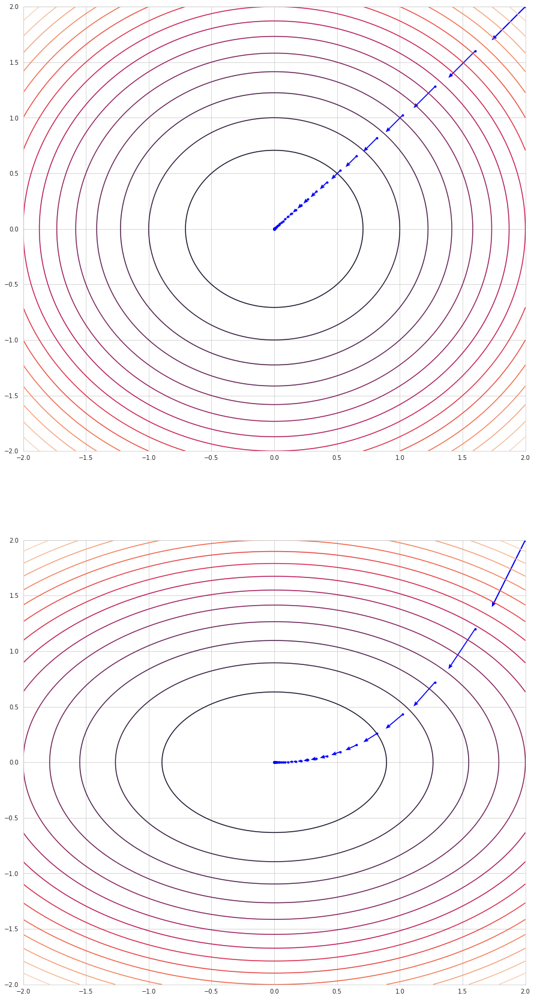

In [315]:
nb_pts, x_mi, x_ma, y_mi, y_ma = 200, -2, 2, -2, 2
fig, ax = plt.subplots(2, 1, figsize=(15, 30))
x, y = np.linspace(x_mi, x_ma, nb_pts), np.linspace(x_mi, x_ma, nb_pts)
X, Y = np.meshgrid(x, y)
## Reshaping X, Y for proper evaluation by input function
x_y = np.vstack([X.reshape(1, -1), Y.reshape(1, -1)]).reshape(1, 2, -1)
## Plotting level curves for extreme cases
extreme_cases = [gammas[0], gammas[-1]]
for i in range(len(extreme_cases)):
    ax[i].set_xlim(x_mi, x_ma)
    ax[i].set_ylim(y_mi, y_ma)
    ax[i].contour(X, Y, test_list_d2[0].value(x_y, gammas[i]).reshape(nb_pts, -1), 15)
    ax[i].quiver(GD_ri_2.loc["quadric_2_{}".format(gammas[i]), "iters"][:, 0], 
                 GD_ri_2.loc["quadric_2_{}".format(gammas[i]), "iters"][:, 1], 
                 GD_ri_2.loc["quadric_2_{}".format(gammas[i]), "iters_dir"][:, 0], 
                 GD_ri_2.loc["quadric_2_{}".format(gammas[i]), "iters_dir"][:, 1],
                 color='b', scale=6, width=0.002, headwidth=4, headlength=5)
    ax[i].plot(GD_ri_2.loc["quadric_2_{}".format(gammas[i]), "iters"][:, 0], 
               GD_ri_2.loc["quadric_2_{}".format(gammas[i]), "iters"][:, 1],
               'b.')

In [316]:
GD_ri_1 = pd.DataFrame(columns=["gamma", "rate", "optimal_pt", "optimal_val", "nb_iter", "iters", "iters_dir"])
GD_list_1 = {}
for t_function in test_list_d2:
    for gamma in gammas:
        GD_list_1[t_function.name] = GD(ddir = dsgd, 
                                        rate = lambda x, f, dir_x, grad, nb_iter, eta : 0.1)
        opt_pt, iters, iters_dir, n_iter = GD_list_1[t_function.name](init_pt_d2, 
                                                     (lambda x: t_function.value (x, gamma)), 
                                                     (lambda x, f, tol : t_function.grad(x, gamma)))
        naming_format = "{}_{}".format(t_function.name, gamma)
        GD_ri_1.loc[naming_format] = pd.Series({ "gamma": gamma, 
                                                 "rate" : 0.01,
                                                 "optimal_pt": opt_pt,
                                                 "optimal_val": t_function.value(opt_pt, gamma),
                                                 "nb_iter": n_iter,
                                                 "iters": iters,
                                                 "iters_dir": iters_dir})
GD_ri_1.loc[:, "gamma": "nb_iter"]

,gamma,rate,optimal_pt,optimal_val,nb_iter
quadric_2_1.0,1.0,0.01,"[[3.2910091146424137e-07, 3.2910091146424137e-...",[2.1661481985318886e-13],140
quadric_2_2.0,2.0,0.01,"[[3.2910091146424137e-07, 1.591732221989278e-07]]",[1.589796392569729e-13],102
quadric_2_3.0,3.0,0.01,"[[4.113761393303017e-07, 5.4975581388799866e-08]]",[1.7829727165741348e-13],88
quadric_2_4.0,4.0,0.01,"[[4.113761393303017e-07, 4.095999999999986e-08]]",[1.7594121441030375e-13],80
quadric_2_5.0,5.0,0.01,"[[4.113761393303017e-07, 0.0]]",[1.692303280103038e-13],70
quadric_2_6.0,6.0,0.01,"[[4.113761393303017e-07, -4.096000000000023e-08]]",[1.792966576103039e-13],80
quadric_2_7.0,7.0,0.01,"[[3.2910091146424137e-07, 2.1990232555520095e-...",[1.1169240222151542e-13],90
quadric_2_8.0,8.0,0.01,"[[4.113761393303017e-07, -3.4381415994968646e-...",[1.7868698213685648e-13],104
quadric_2_9.0,9.0,0.01,"[[3.2910091146424137e-07, 3.533694129556809e-08]]",[1.1954570470773225e-13],150
quadric_2_10.0,10.0,0.01,"[[2.0, 2.0]]",[44.0],1000


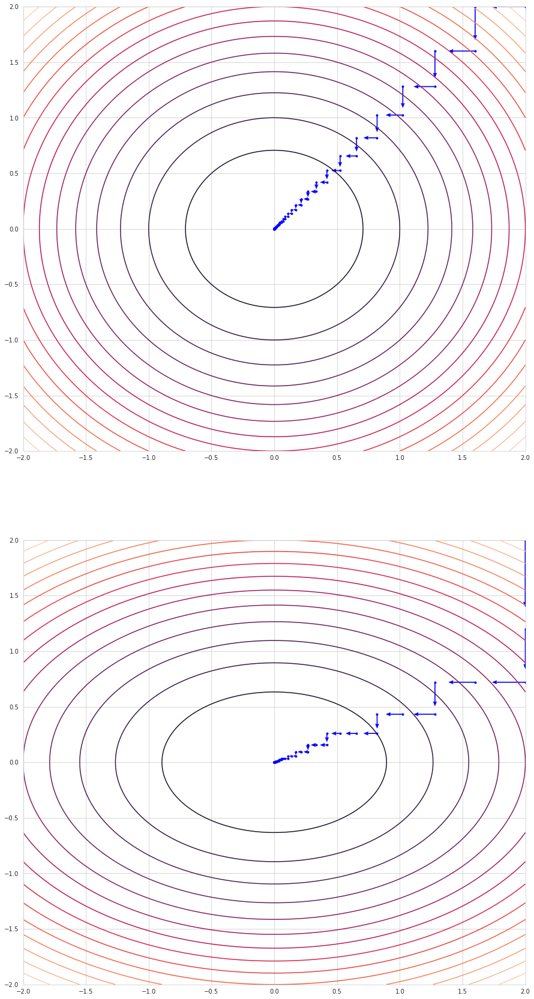

In [317]:
nb_pts, x_mi, x_ma, y_mi, y_ma = 200, -2, 2, -2, 2
fig, ax = plt.subplots(2, 1, figsize=(15, 30))
x, y = np.linspace(x_mi, x_ma, nb_pts), np.linspace(x_mi, x_ma, nb_pts)
X, Y = np.meshgrid(x, y)
## Reshaping X, Y for proper evaluation by input function
x_y = np.vstack([X.reshape(1, -1), Y.reshape(1, -1)]).reshape(1, 2, -1)
## Plotting level curves for extreme cases
extreme_cases = [gammas[0], gammas[-1]]
for i in range(len(extreme_cases)):
    ax[i].set_xlim(x_mi, x_ma)
    ax[i].set_ylim(y_mi, y_ma)
    ax[i].contour(X, Y, test_list_d2[0].value(x_y, gammas[i]).reshape(nb_pts, -1), 15)
    ax[i].quiver(GD_ri_1.loc["quadric_2_{}".format(gammas[i]), "iters"][:, 0], 
                 GD_ri_1.loc["quadric_2_{}".format(gammas[i]), "iters"][:, 1], 
                 GD_ri_1.loc["quadric_2_{}".format(gammas[i]), "iters_dir"][:, 0], 
                 GD_ri_1.loc["quadric_2_{}".format(gammas[i]), "iters_dir"][:, 1],
                 color='b', scale=6, width=0.002, headwidth=4, headlength=5)
    ax[i].plot(GD_ri_1.loc["quadric_2_{}".format(gammas[i]), "iters"][:, 0], 
               GD_ri_1.loc["quadric_2_{}".format(gammas[i]), "iters"][:, 1],
               'b.')

On en vient désormais à comparer ces deux algos. Vu que les mise-à-jour internes semble demander le même nombre d'itérations il est raisonnable de s'intéresser en premier temps au nombre d'itérations.

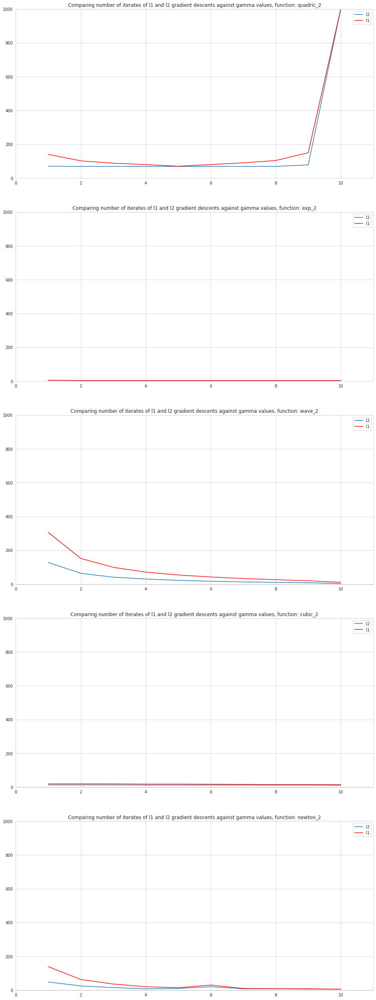

In [318]:
gammas = np.linspace(1, 10, 10)
fig, ax = plt.subplots(len(test_list_d2), 1, figsize=(16, 9*len(test_list_d2)))
for i, func in enumerate(test_list_d2):
    ax[i].set_xlim(0, 11)
    ax[i].set_ylim(-1, 1000)
    ax[i].plot(GD_ri_2["gamma"].values[int(np.max(gammas) * i):int(np.max(gammas) * (i + 1))], GD_ri_2["nb_iter"].values[int(np.max(gammas) * i):int(np.max(gammas) * (i + 1))], label="l2")
    ax[i].plot(GD_ri_1["gamma"].values[int(np.max(gammas) * i):int(np.max(gammas) * (i + 1))], GD_ri_1["nb_iter"].values[int(np.max(gammas) * i):int(np.max(gammas) * (i + 1))], "r", label="l1")
    ax[i].set_title("Comparing number of iterates of l1 and l2 gradient descents against gamma values, function: {}".format(func.name))
    ax[i].legend()

## Sensibilité de GD aux conditionnements de la hessienne

On s'intéresse dans cette section au comportement de la descente de gradients vis-à-vis de la géométrie locale de l'itéré courant. Cette étude va vous permettre de comprendre en quoi le manque de symétrie locale des fonctions objectifs rend plus lente la convergence de la descente de gradient.

1. En utilisant la GD classique à pas constant tracer dans les cas de nombres de conditionnements qui ne dépendent que des paramètres de vos familles tests ce nombre contre le nombre d'itérations de la GD.

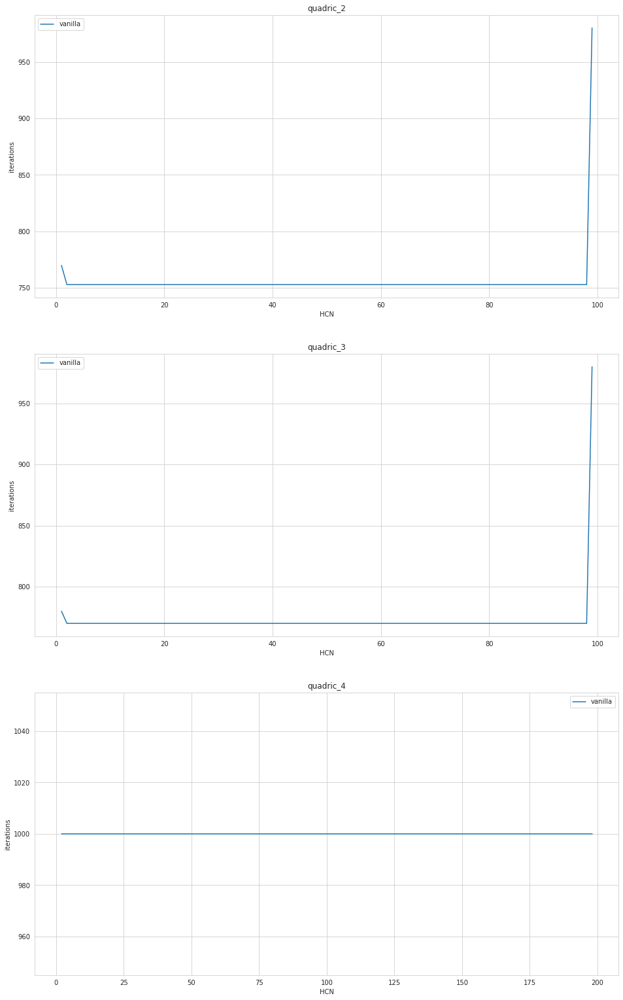

In [319]:
test_list_hcn = [test_family for test_family in test_list if 'quadric' in test_family.name and test_family.dim > 1]
fig, ax = plt.subplots(len(test_list_hcn), 1, figsize=(16, 9*len(test_list_hcn)))
gammas = np.arange(1, 100)
gd = GD()
for index, func in enumerate(test_list_hcn):
    df = pd.DataFrame(columns=["family", "HCN", "iterations"])
    for gamma in gammas:
        opt_pt, iters, iters_dir, n_iter = gd(np.full((1, func.dim), 2), (lambda x: func.value (x, gamma)), (lambda x, f, tol : func.grad(x, gamma)))
        df = df.append({"family": func.name,"HCN": func.HCN(1, gamma), "iterations": n_iter}, ignore_index=True)
    df = df.set_index("family")
    #fig, ax = plt.subplots(figsize=(16, 9))
    ax[index].plot(df["HCN"].values, df["iterations"].values, label="vanilla")
    ax[index].set_title(func.name)
    ax[index].set_xlabel("HCN")
    ax[index].set_ylabel("iterations")
    ax[index].legend()


2. Faire de même avec le cas de *backtracking*

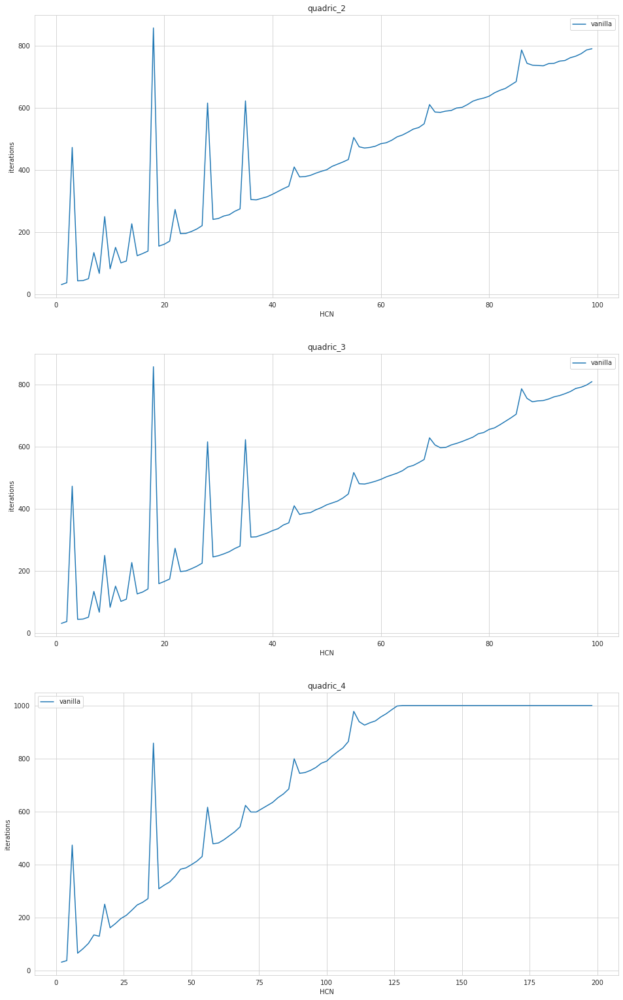

In [320]:
bt_rate = backtracking()
test_list_hcn = [test_family for test_family in test_list if 'quadric' in test_family.name and test_family.dim > 1]
fig, ax = plt.subplots(len(test_list_hcn), 1, figsize=(16, 9*len(test_list_hcn)))
gammas = np.arange(1, 100)
gd = GD(rate = bt_rate)
for index, func in enumerate(test_list_hcn):
    df = pd.DataFrame(columns=["family", "HCN", "iterations"])
    for gamma in gammas:
        opt_pt, iters, iters_dir, n_iter = gd(np.full((1, func.dim), 2), (lambda x: func.value (x, gamma)), (lambda x, f, tol : func.grad(x, gamma)))
        df = df.append({"family": func.name,"HCN": func.HCN(1, gamma), "iterations": n_iter}, ignore_index=True)
    df = df.set_index("family")
    #fig, ax = plt.subplots(figsize=(16, 9))
    ax[index].plot(df["HCN"].values, df["iterations"].values, label="vanilla")
    ax[index].set_title(func.name)
    ax[index].set_xlabel("HCN")
    ax[index].set_ylabel("iterations")
    ax[index].legend()

3. Que constatez-vous?

On constate que le nombre d'itérations a tendance à augmenter parallèlement à l'augmentation du nombre de conditionnement de la hessienne de la fonction. De plus l'utilisation du backtracking pour décider du pas de la descente de gradient permet de réduire drastiquement le nombre d'iterations. On remarque également que la méthode du backtracking ne donne pas une évolution linéaire du nombre d'iterations en fonction du nombre de conditionnement. Au contraire, les variations du nombre d'itérations pour des nombres de conditionnements assez proches peuvent être très importantes.

## Accélérations

Il y a des stratégies standards d'accélération de descente de gradients ; on en invente même tous les ans. Il n'y a pas nécessairement de relation d'ordre entre celles-ci, certaines sont plus adaptées que d'autres à des problèmes spécifiques et inversement. On propose d'en implémenter $3$ ici, il s'agit en particulier d'un travail bibliographique (simple).

1. Implémenter la *Momentum Optimisation*. Cherchez à en comprendre le sens.

cf classe GD

2. Implémenter la *Nesterov Optimisation*. Cherchez à en comprendre le sens.

cf classe GD

3. Implémenter la *Adam Optimisation*. Cherchez à en comprendre le sens.

cf classe GD

4. Comparer les descentes de gradient pour chacune des optimisations précédentes.

In [86]:
df = pd.DataFrame(columns=["family", "optimizer", "optimal_point", "optimal_value", "number of iterations", "learning rate", "iters_dir", "iters"])
#gammas = np.arange(1, 11)
family_list = [local_minimum, saddle_point, elliptic_bowl, hills, plateau, quad_I, cubic_I, exp_I, multi_sinks, quad_II, quad_III, quad_IIII, wave_II, cubic_II, newton_comparison_function, exp_II]
init_points = [np.array([[2, 2]]), np.array([[2, 2]]), np.array([[2, 2]]), np.array([[2, 2]]), np.array([[2, 2]]), np.array([1]), np.array([1]), np.array([1]), np.array([1]), np.array([[2, 2]]), np.array([[2, 2, 2]]), np.array([[2, 2, 2, 2]]), np.array([[2, 2]]), np.array([[2, 2]]), np.array([[2, 2]]), np.array([[2, 2]])]
rates = [0.1, 0.01, 0.001]
for family, init_point in zip(family_list, init_points):
    #for gamma in gammas:
    for learning_rate in rates:
        gd = GD(rate=lambda x, f, dir_x, grad, nb_iter, eta : learning_rate)
        opt_pt, iters, iters_dir, n_iter = gd(init_point, (lambda x: family.value (x, 1)), (lambda x, f, tol : family.grad(x, 1)))
        df = df.append({"family": family.name, "optimizer": "vanilla", "optimal_point": opt_pt, "optimal_value": family.value(opt_pt, 1), "number of iterations": n_iter, "learning rate": learning_rate, "iters_dir": iters_dir, "iters": iters}, ignore_index=True)

        opt_pt, iters, iters_dir, n_iter = gd.momentum(init_point, (lambda x: family.value (x, 1)), (lambda x, f, tol : family.grad(x, 1)), learning_rate,  0.9)
        df = df.append({"family": family.name, "optimizer": "momentum", "optimal_point": opt_pt, "optimal_value": family.value(opt_pt, 1), "number of iterations": n_iter, "learning rate": learning_rate, "iters_dir": iters_dir, "iters": iters}, ignore_index=True)

        opt_pt, iters, iters_dir, n_iter = gd.nesterov(init_point, (lambda x: family.value (x, 1)), (lambda x, f, tol : family.grad(x, 1)), learning_rate,  0.9)
        df = df.append({"family": family.name, "optimizer": "nesterov", "optimal_point": opt_pt, "optimal_value": family.value(opt_pt, 1), "number of iterations": n_iter, "learning rate": learning_rate, "iters_dir": iters_dir, "iters": iters}, ignore_index=True)

        opt_pt, iters, iters_dir, n_iter = gd.adam(init_point, (lambda x: family.value (x, 1)), (lambda x, f, tol : family.grad(x, 1)), learning_rate, 0.9, 0.999, 1e-8)
        df = df.append({"family": family.name, "optimizer": "adam", "optimal_point": opt_pt, "optimal_value": family.value(opt_pt, 1), "number of iterations": n_iter, "learning rate": learning_rate, "iters_dir": iters_dir, "iters": iters}, ignore_index=True)
df = df.set_index("family")
df

(26, 2)
(298, 2)
(1001, 2)
(155, 2)
(1001, 2)
(1001, 2)
(37, 2)
(427, 2)
(1001, 2)
(78, 2)
(833, 2)
(1001, 2)
(1001, 2)
(1001, 2)
(1001, 2)
(68, 1)
(740, 1)
(1001, 1)
(31, 1)
(212, 1)
(1001, 1)
(66, 1)
(716, 1)
(1001, 1)
(495, 1)
(1001, 1)
(78, 1)
(71, 2)
(771, 2)
(1001, 2)
(72, 3)
(781, 3)
(1001, 3)
(144, 4)
(1001, 4)
(1001, 4)
(129, 2)
(1001, 2)
(1001, 2)
(14, 2)
(168, 2)
(1001, 2)
(49, 2)
(476, 2)
(1001, 2)
(6, 2)
(380, 2)
(1001, 2)


,optimizer,optimal_point,optimal_value,number of iterations,learning rate,iters_dir,iters
family,,,,,,,
local_minimum,vanilla,"[[0.8053316754113578, 2.1326895985949334e-22]]",[-0.17883133142310992],25,0.100,"[[-0.4000000000138879, -0.4000000000277759], [...","[[2.0, 2.0], [1.599999999986112, 1.59999999997..."
local_minimum,momentum,"[[-0.9053179046407552, 1.831368591321659e-08]]",[-1.0927319730155665],326,0.100,"[[-0.4000000000138879, -0.4000000000277759], [...","[[2.0, 2.0], [1.2399999999736129, 1.2399999999..."
local_minimum,nesterov,"[[0.8053316538684934, 9.107357442538806e-17]]",[-0.17883133142309948],53,0.100,"[[-0.4000000000138879, -0.4000000000277759], [...","[[2.0, 2.0], [1.3119998807690219, 1.3119996944..."
local_minimum,adam,"[[-0.9053178956420564, 3.427694752922871e-08]]",[-1.0927319730155534],325,0.100,"[[-0.09999999975, -0.09999999975], [-0.0998335...","[[2.0, 2.0], [1.90000000025, 1.90000000025], [..."
local_minimum,vanilla,"[[0.805331602007815, 5.6259341668110235e-11]]",[-0.17883133142306074],297,0.010,"[[-0.04000000000138879, -0.04000000000277759],...","[[2.0, 2.0], [1.9599999999986113, 1.9599999999..."
...,...,...,...,...,...,...,...
exp_2,adam,"[[0.03287577079853157, 0.03287577079853157]]",[4.004324822998712],1000,0.010,"[[-0.009999999998167822, -0.009999999998167822...","[[2.0, 2.0], [1.990000000001832, 1.99000000000..."
exp_2,vanilla,"[[0.01742343567222539, 0.01742343567222539]]",[4.0012144273254115],1000,0.001,"[[-0.05457983439425551, -0.05457983439425551],...","[[2.0, 2.0], [1.9454201656057446, 1.9454201656..."
exp_2,momentum,"[[-1.1154558041838004e-07, -1.1154558041838004...",[4.00000000000005],258,0.001,"[[-0.05457983439425551, -0.05457983439425551],...","[[2.0, 2.0], [1.8962983146509145, 1.8962983146..."


No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles wi

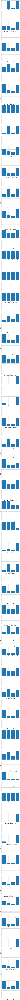

In [96]:
nb_figures = len(rates)*len(family_list) * 2
fig, ax = plt.subplots(nb_figures, 1, figsize=(16, 9*nb_figures))
optimizers = ["vanilla", "momentum", "nesterov", "adam"]
for family_index, family in enumerate(family_list):
    groups = df.groupby("family")
    groups = groups.get_group(family.name)
    for rate_index, rate in enumerate(rates):
        group = groups[groups["learning rate"] == rate]
        index = (family_index * len(rates) + rate_index) * 2
        ax[index].bar(optimizers, group["number of iterations"])
        ax[index].set_title("optimizer comparison, optimizers against number of iterations, family = {}, learning rate = {}".format(family.name, rate))
        ax[index].set_xlabel("optimizers")
        ax[index].set_ylabel("number of iterations")
        ax[index].legend()
        ax[index + 1].scatter(optimizers, group["optimal_value"])
        ax[index + 1].set_title("optimizer comparison, optimizers against optimal value, family = {}, learning rate = {}".format(family.name, rate))
        ax[index + 1].set_xlabel("optimizers")
        ax[index + 1].set_ylabel("optimal_value")
        ax[index + 1].legend()

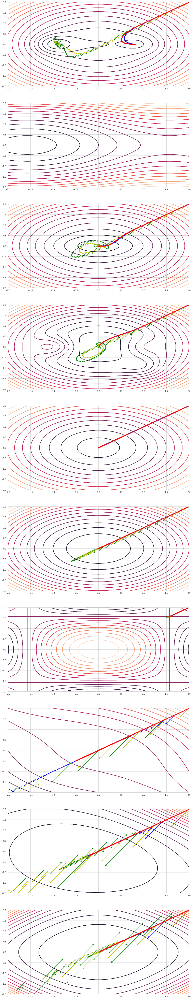

In [104]:
family_list_2d = [x for x in family_list if x.dim == 2]
nb_pts, x_mi, x_ma, y_mi, y_ma = 200, -2, 2, -2, 2
x, y = np.linspace(x_mi, x_ma, nb_pts), np.linspace(x_mi, x_ma, nb_pts)
X, Y = np.meshgrid(x, y)
optimizers = ["vanilla", "momentum", "nesterov", "adam"]
colors = ['b', 'g', 'y', 'r']
#colors_point = ['b.', 'g.', 'y.', 'r.']
## Reshaping X, Y for proper evaluation by input function
x_y = np.vstack([X.reshape(1, -1), Y.reshape(1, -1)]).reshape(1, 2, -1)
## Plotting level curves for extreme cases
fig, ax = plt.subplots(len(family_list_2d), 1, figsize=(16, 9*len(family_list_2d)))
for family_index, family in enumerate(family_list_2d):
    groups = df.loc[family.name]
    for optimizer, color in zip(optimizers, colors):
        group = groups[(groups['optimizer'] == optimizer) & (groups['learning rate'] == 0.01)]
        ax[family_index].set_xlim(x_mi, x_ma)
        ax[family_index].set_ylim(y_mi, y_ma)
        ax[family_index].contour(X, Y, family.value(x_y, 1).reshape(nb_pts, -1), 15)
        ax[family_index].quiver(group["iters"].values[0][:, 0], group["iters"].values[0][:, 1], group["iters_dir"].values[0][:, 0], group["iters_dir"].values[0][:, 1], color=color, scale=6, width=0.002, headwidth=4, headlength=5)
        ax[family_index].plot(group["iters"].values[0][:, 0], group["iters"].values[0][:, 1], color+'.')

local_minimum
saddle_point_II
elliptic_bowl_II
hills_II
plateau_II
quadric_2
quadratic_1
cubic_1
exp_1
multi_sinks_1
quadric_3
quadric_4
wave_2
cubic_2
newton_2
exp_2


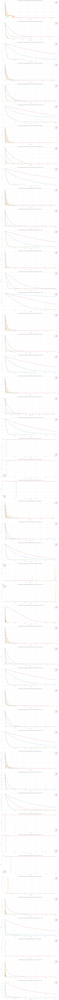

In [67]:
rates = [0.1, 0.01, 0.001]
family_list = [local_minimum, saddle_point, elliptic_bowl, hills, plateau, quad_II, quad_I, cubic_I, exp_I, multi_sinks, quad_III, quad_IIII, wave_II, cubic_II, newton_comparison_function, exp_II]
nb_figures = len(rates)*len(family_list)
fig, ax = plt.subplots(nb_figures, 1, figsize=(24, 9*nb_figures))
init_points = [np.array([[2, 2]]), np.array([[2, 2]]), np.array([[2, 2]]), np.array([[2, 2]]), np.array([[2, 2]]), np.array([[2, 2]]), np.array([1]), np.array([1]), np.array([1]), np.array([1]), np.array([[2, 2, 2]]), np.array([[2, 2, 2, 2]]), np.array([[2, 2]]), np.array([[2, 2]]), np.array([[2, 2]]), np.array([[2, 2]])]
for family_index, (family, init_point) in enumerate(zip(family_list, init_points)):
    for rate_index, learning_rate in enumerate(rates):
        gd = GD(rate=lambda x, f, dir_x, grad, nb_iter, eta : learning_rate)
        opt_pt, iters_vanilla, iters_dir, n_iter_vanilla = gd(init_point, (lambda x: family.value (x, 1)), (lambda x, f, tol : family.grad(x, 1)))

        opt_pt, iters_momentum, iters_dir, n_iter_momentum = gd.momentum(init_point, (lambda x: family.value (x, 1)), (lambda x, f, tol : family.grad(x, 1)), learning_rate,  0.9)

        opt_pt, iters_nesterov, iters_dir, n_iter_nesterov = gd.nesterov(init_point, (lambda x: family.value (x, 1)), (lambda x, f, tol : family.grad(x, 1)), learning_rate,  0.9)

        opt_pt, iters_adam, iters_dir, n_iter_adam = gd.adam(init_point, (lambda x: family.value (x, 1)), (lambda x, f, tol : family.grad(x, 1)), learning_rate, 0.9, 0.999, 1e-8)

        index = family_index * len(rates) + rate_index
        ax[index].plot(np.arange(0, n_iter_vanilla + 1), family.value(iters_vanilla, 1), label='vanilla')
        ax[index].plot(np.arange(0, n_iter_momentum + 1), family.value(iters_momentum, 1), label='momentum')
        ax[index].plot(np.arange(0, n_iter_nesterov + 1), family.value(iters_nesterov, 1), label='nesterov')
        ax[index].plot(np.arange(0, n_iter_adam + 1), family.value(iters_adam, 1), label='adam')
        ax[index].set_title("optimizer comparison, function value against iterations, family = {}, learning rate = {}".format(family.name, learning_rate))
        ax[index].set_xlabel("iterations")
        ax[index].set_ylabel("f(x)")
        ax[index].legend()

On remarque que la methode adam est plus lente à converger. Cela est notamment perceptible pour des learning rates plus faibles comme par example 0.001.

## Méthode de Newton

1. Implémenter la méthode de Newton.

cf classe GD

2. Qu'est-ce qu'un exemple pertinent pour comparer la méthode de Newton au méthode de descente vu précédemment?

Si la fonction est quadratique alors la méthode de newton converge en seulement une iteration car cette methode cherche a minimiser une approximation quadratique de la fonction en utilisant la formule de taylor pour les developpements limités. Si la fonction est linéaire alors on a une dérivée seconde nulle donc on veut éviter ce cas. Si la fonction est de dimension trop grande alors le calcul de l'inverse de la hessienne sera trop long donc on veut aussi éviter les fonctions de dimension trop grande. On va également chercher une fonction continue et différentiable en tout point.

3. Comparer la méthode de Newton aux descentes précédentes.

In [64]:
df = pd.DataFrame(columns=["family", "gamma", "optimizer", "optimal_point", "optimal_value", "iterations"])
gammas = np.arange(1, 11)
gd = GD()
family_list = [quad_IIII, quad_III, quad_II, quad_I, cubic_I, exp_I, multi_sinks]
init_points = [np.array([[2, 2, 2, 2]]), np.array([[2, 2, 2]]), np.array([[2, 2]]), np.array([1]), np.array([1]), np.array([1]), np.array([1])]
for family, init_point in zip(family_list, init_points):
    for gamma in gammas:

        opt_pt, iters, iters_dir, n_iter = gd(init_point, (lambda x: family.value (x, gamma)), (lambda x, f, tol : family.grad(x, gamma)))
        df = df.append({"family": family.name,"gamma": gamma, "optimizer": "vanilla", "optimal_point": opt_pt, "optimal_value": family.value(opt_pt, gamma), "iterations": n_iter}, ignore_index=True)

        opt_pt, iters, iters_dir, n_iter = gd.momentum(init_point, (lambda x: family.value (x, gamma)), (lambda x, f, tol : family.grad(x, gamma)), 0.01,  0.9)
        df = df.append({"family": family.name,"gamma": gamma, "optimizer": "momentum", "optimal_point": opt_pt, "optimal_value": family.value(opt_pt, gamma), "iterations": n_iter}, ignore_index=True)

        opt_pt, iters, iters_dir, n_iter = gd.nesterov(init_point, (lambda x: family.value (x, gamma)), (lambda x, f, tol : family.grad(x, gamma)), 0.01,  0.9)
        df = df.append({"family": family.name,"gamma": gamma, "optimizer": "nesterov", "optimal_point": opt_pt, "optimal_value": family.value(opt_pt, gamma), "iterations": n_iter}, ignore_index=True)

        opt_pt, iters, iters_dir, n_iter = gd.adam(init_point, (lambda x: family.value (x, gamma)), (lambda x, f, tol : family.grad(x, gamma)), 0.001, 0.9, 0.999, 1e-8)
        df = df.append({"family": family.name,"gamma": gamma, "optimizer": "adam", "optimal_point": opt_pt, "optimal_value": family.value(opt_pt, gamma), "iterations": n_iter}, ignore_index=True)

        opt_pt, iters, iters_dir, n_iter = gd.newton(init_point, (lambda x: family.value (x, gamma)), (lambda x, f, tol : family.grad(x, gamma)), (lambda x, f, tol : family.hess(x, gamma)))
        df = df.append({"family": family.name,"gamma": gamma, "optimizer": "newton", "optimal_point": opt_pt, "optimal_value": family.value(opt_pt, gamma), "iterations": n_iter}, ignore_index=True)
df = df.set_index("family")
df

,gamma,optimizer,optimal_point,optimal_value,iterations
family,,,,,
quadric_4,1,vanilla,"[[8.634249482131659e-05, 3.3659347144319058e-0...",[1.118253962928314e-08],1000
quadric_4,1,momentum,"[[-5.44455669688699e-07, -1.5621983525118126e-...",[4.4489201075351374e-13],268
quadric_4,1,nesterov,"[[1.4937368205123004e-07, 4.025680666188688e-0...",[1.9552979359556694e-13],244
quadric_4,1,adam,"[[1.1199831383482506, 1.1199831361932133, 1.11...",[3.1359055706337804],1000
quadric_4,1,newton,"[[0.0, 0.0, 0.0, 0.0]]",[0.0],1
...,...,...,...,...,...
multi_sinks_1,10,vanilla,[[4.280778632392811e-08]],[[20.000000000000018]],72
multi_sinks_1,10,momentum,[[7.627165930574863e-09]],[[20.0]],202
multi_sinks_1,10,nesterov,[[-3.656892402054455e-09]],[[20.0]],89


In [65]:
df = pd.DataFrame(columns=["family", "gamma", "optimizer", "optimal_point", "optimal_value", "iterations"])
gammas = np.arange(1, 11)
gd = GD()
for gamma in gammas:
    opt_pt, iters, iters_dir, n_iter = gd(np.array([[2, 2]]), (lambda x: newton_comparison_function.value (x, gamma)), (lambda x, f, tol : newton_comparison_function.grad(x, gamma)))
    df = df.append({"family": newton_comparison_function.name,"gamma": gamma, "optimizer": "vanilla", "optimal_point": opt_pt, "optimal_value": newton_comparison_function.value(opt_pt, gamma), "iterations": n_iter}, ignore_index=True)

    opt_pt, iters, iters_dir, n_iter = gd.momentum(np.array([[2, 2]]), (lambda x: newton_comparison_function.value (x, gamma)), (lambda x, f, tol : newton_comparison_function.grad(x, gamma)), 0.01,  0.9)
    df = df.append({"family": newton_comparison_function.name,"gamma": gamma, "optimizer": "momentum", "optimal_point": opt_pt, "optimal_value": newton_comparison_function.value(opt_pt, gamma), "iterations": n_iter}, ignore_index=True)

    opt_pt, iters, iters_dir, n_iter = gd.nesterov(np.array([[2, 2]]), (lambda x: newton_comparison_function.value (x, gamma)), (lambda x, f, tol : newton_comparison_function.grad(x, gamma)), 0.01,  0.9)
    df = df.append({"family": newton_comparison_function.name,"gamma": gamma, "optimizer": "nesterov", "optimal_point": opt_pt, "optimal_value": newton_comparison_function.value(opt_pt, gamma), "iterations": n_iter}, ignore_index=True)

    opt_pt, iters, iters_dir, n_iter = gd.adam(np.array([[2, 2]]), (lambda x: newton_comparison_function.value (x, gamma)), (lambda x, f, tol : newton_comparison_function.grad(x, gamma)), 0.001, 0.9, 0.999, 1e-8)
    df = df.append({"family": newton_comparison_function.name,"gamma": gamma, "optimizer": "adam", "optimal_point": opt_pt, "optimal_value": newton_comparison_function.value(opt_pt, gamma), "iterations": n_iter}, ignore_index=True)

    opt_pt, iters, iters_dir, n_iter = gd.newton(np.array([[2, 2]]), (lambda x: newton_comparison_function.value (x, gamma)), (lambda x, f, tol : newton_comparison_function.grad(x, gamma)), (lambda x, f, tol : newton_comparison_function.hess(x, gamma)))
    df = df.append({"family": newton_comparison_function.name,"gamma": gamma, "optimizer": "newton", "optimal_point": opt_pt, "optimal_value": newton_comparison_function.value(opt_pt, gamma), "iterations": n_iter}, ignore_index=True)
df = df.set_index("family")
df

,gamma,optimizer,optimal_point,optimal_value,iterations
family,,,,,
newton_2,1,vanilla,"[[-0.28357142234842714, -0.28357142234842714]]",[0.7279690463383578],475
newton_2,1,momentum,"[[-0.28357183818262677, -0.28357183818262677]]",[0.7279690463383188],273
newton_2,1,nesterov,"[[-0.2835717018901673, -0.2835717018901673]]",[0.7279690463382122],190
newton_2,1,adam,"[[1.2810300270506856, 1.2810300270506856]]",[16.244569126986676],1000
newton_2,1,newton,"[[-0.2835716427326654, -0.2835716427326654]]",[0.727969046338202],7
newton_2,2,vanilla,"[[-0.1758667260189943, -0.1758667260189943]]",[0.8271840261276151],284
newton_2,2,momentum,"[[-0.17586687447243537, -0.17586687447243537]]",[0.8271840261275262],270
newton_2,2,nesterov,"[[-0.1758668733620996, -0.1758668733620996]]",[0.8271840261275261],182
newton_2,2,adam,"[[1.2680741648486162, 1.2680741648486162]]",[19.062975342062096],1000


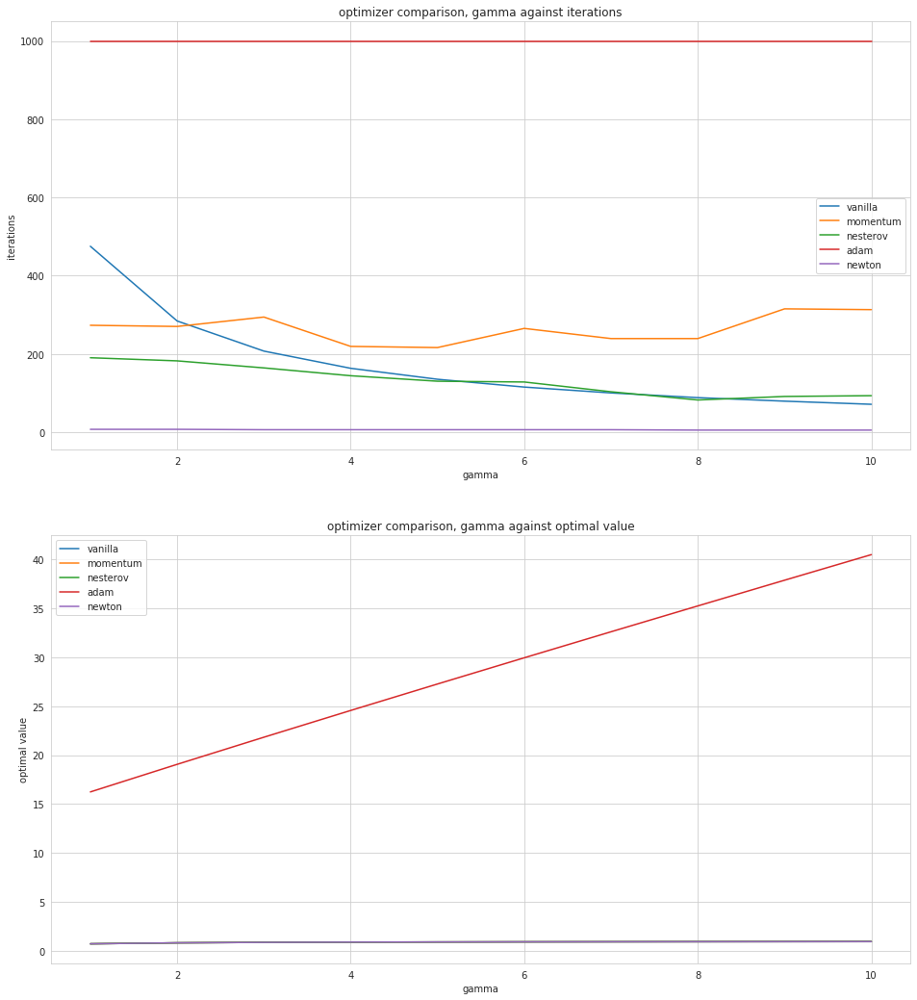

In [66]:
fig, ax = plt.subplots(2, 1, figsize=(16, 9*2))
optimizers = ["vanilla", "momentum", "nesterov", "adam", "newton"]
for optimizer in optimizers:
    group = df[df["optimizer"] == optimizer]
    ax[0].plot(group["gamma"], group["iterations"], label=optimizer)
    ax[0].set_title("optimizer comparison, gamma against iterations")
    ax[0].set_xlabel("gamma")
    ax[0].set_ylabel("iterations")
    ax[0].legend()
    ax[1].plot(group["gamma"], group["optimal_value"], label=optimizer)
    ax[1].set_title("optimizer comparison, gamma against optimal value")
    ax[1].set_xlabel("gamma")
    ax[1].set_ylabel("optimal value")
    ax[1].legend()

En general, la methode de newton est plus rapide pour converger si le point initial est relativement proche de la solution. Cela s'explique par le fait qu'on utilise la dérivée seconde ce qui nous donne davantage d'information. Malheureusement le calcul de la derivée seconde est trop lent pour pouvoir utiliser la méthode de newton sur des fonctions de dimension très grandes.

Ci dessous, un cas où la methode de newton tombe dans une boucle infinie et ne converge pas.

In [67]:
df = pd.DataFrame(columns=["family", "gamma", "optimizer", "optimal_point", "optimal_value", "iterations"])
gammas = np.arange(1, 11)
gd = GD()
opt_pt, iters, iters_dir, n_iter = gd(np.array([0]), (lambda x: newton_fail.value (x, 1)), (lambda x, f, tol : newton_fail.grad(x, 1)))
df = df.append({"family": newton_fail.name,"gamma": 1, "optimizer": "vanilla", "optimal_point": opt_pt, "optimal_value": newton_fail.value(opt_pt, 1), "iterations": n_iter}, ignore_index=True)

opt_pt, iters, iters_dir, n_iter = gd.momentum(np.array([0]), (lambda x: newton_fail.value (x, 1)), (lambda x, f, tol : newton_fail.grad(x, 1)), 0.01,  0.9)
df = df.append({"family": newton_fail.name,"gamma": 1, "optimizer": "momentum", "optimal_point": opt_pt, "optimal_value": newton_fail.value(opt_pt, 1), "iterations": n_iter}, ignore_index=True)

opt_pt, iters, iters_dir, n_iter = gd.nesterov(np.array([0]), (lambda x: newton_fail.value (x, 1)), (lambda x, f, tol : newton_fail.grad(x, 1)), 0.01,  0.9)
df = df.append({"family": newton_fail.name,"gamma": 1, "optimizer": "nesterov", "optimal_point": opt_pt, "optimal_value": newton_fail.value(opt_pt, 1), "iterations": n_iter}, ignore_index=True)

opt_pt, iters, iters_dir, n_iter = gd.adam(np.array([0]), (lambda x: newton_fail.value (x, 1)), (lambda x, f, tol : newton_fail.grad(x, 1)), 0.001, 0.9, 0.999, 1e-8)
df = df.append({"family": newton_fail.name,"gamma": 1, "optimizer": "adam", "optimal_point": opt_pt, "optimal_value": newton_fail.value(opt_pt, 1), "iterations": n_iter}, ignore_index=True)

opt_pt, iters, iters_dir, n_iter = gd.newton(np.array([0]), (lambda x: newton_fail.value (x, 1)), (lambda x, f, tol : newton_fail.grad(x, 1)), (lambda x, f, tol : newton_fail.hess(x, 1)))
df = df.append({"family": newton_fail.name,"gamma": 1, "optimizer": "newton", "optimal_point": opt_pt, "optimal_value": newton_fail.value(opt_pt, 1), "iterations": n_iter}, ignore_index=True)
df = df.set_index("family")
df

,gamma,optimizer,optimal_point,optimal_value,iterations
family,,,,,
newton_fail,1,vanilla,[[-1.769292223511085]],[-4.219136248741524],250
newton_fail,1,momentum,[[-1.7692922450112056]],[-4.219136248741542],230
newton_fail,1,nesterov,[[-1.769292289756137]],[-4.219136248741571],152
newton_fail,1,adam,[[-1.0949740314587704]],[-3.0295350485560233],1000
newton_fail,1,newton,[[0.0]],[0.0],1000


Ci dessous un mauvais choix de point initial entraine une dérivée seconde nulle ce qui a pour consequence de lever une erreur. La division par zero étant impossible. La fonction est $$x - \frac{x^3}{3}$$ la dérivée seconde est $$-2x$$ Si on choisit zero comme point initial la derivée seconde est nulle.

In [68]:
df = pd.DataFrame(columns=["family", "gamma", "optimizer", "optimal_point", "optimal_value", "iterations"])
gammas = np.arange(1, 11)
gd = GD()
opt_pt, iters, iters_dir, n_iter = gd(np.array([0]), (lambda x: newton_fail_second.value (x, 1)), (lambda x, f, tol : newton_fail_second.grad(x, 1)))
df = df.append({"family": newton_fail_second.name,"gamma": 1, "optimizer": "vanilla", "optimal_point": opt_pt, "optimal_value": newton_fail_second.value(opt_pt, 1), "iterations": n_iter}, ignore_index=True)

opt_pt, iters, iters_dir, n_iter = gd.momentum(np.array([0]), (lambda x: newton_fail_second.value (x, 1)), (lambda x, f, tol : newton_fail_second.grad(x, 1)), 0.01,  0.9)
df = df.append({"family": newton_fail_second.name,"gamma": 1, "optimizer": "momentum", "optimal_point": opt_pt, "optimal_value": newton_fail_second.value(opt_pt, 1), "iterations": n_iter}, ignore_index=True)

opt_pt, iters, iters_dir, n_iter = gd.nesterov(np.array([0]), (lambda x: newton_fail_second.value (x, 1)), (lambda x, f, tol : newton_fail_second.grad(x, 1)), 0.01,  0.9)
df = df.append({"family": newton_fail_second.name,"gamma": 1, "optimizer": "nesterov", "optimal_point": opt_pt, "optimal_value": newton_fail_second.value(opt_pt, 1), "iterations": n_iter}, ignore_index=True)

opt_pt, iters, iters_dir, n_iter = gd.adam(np.array([0]), (lambda x: newton_fail_second.value (x, 1)), (lambda x, f, tol : newton_fail_second.grad(x, 1)), 0.001, 0.9, 0.999, 1e-8)
df = df.append({"family": newton_fail_second.name,"gamma": 1, "optimizer": "adam", "optimal_point": opt_pt, "optimal_value": newton_fail_second.value(opt_pt, 1), "iterations": n_iter}, ignore_index=True)

opt_pt, iters, iters_dir, n_iter = gd.newton(np.array([0]), (lambda x: newton_fail_second.value (x, 1)), (lambda x, f, tol : newton_fail_second.grad(x, 1)), (lambda x, f, tol : newton_fail_second.hess(x, 1)))
df = df.append({"family": newton_fail_second.name,"gamma": 1, "optimizer": "newton", "optimal_point": opt_pt, "optimal_value": newton_fail_second.value(opt_pt, 1), "iterations": n_iter}, ignore_index=True)
df = df.set_index("family")
df

LinAlgError: Singular matrix

## Cas pratique : la régression (YAT)

Dans cette section on attend de vous que vous implémtentier une régression linéaire (puis polynomiale) à la main. Il revient à vous d'effectuer l'étude bibliographique (ou de revoir les documents à votre disposition dans le cours et / ou mon git) pour éventuellement vous aider. À vous de pousser cette étude là où vous souhaitez ; j'attends de vous que vous puissiez entrevoir le besoin de régularisation, sujet abordé en second TP.

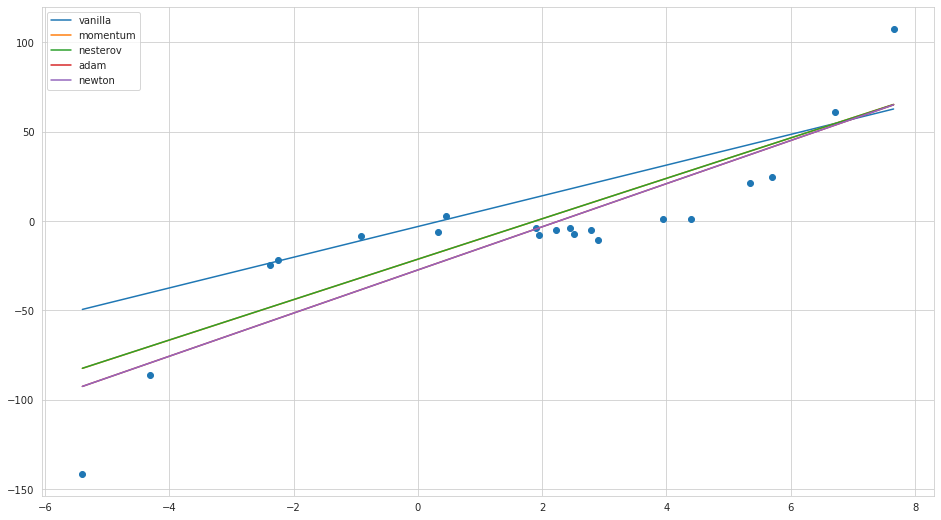

In [69]:
def vanilla_gd(m, c, X, Y, rate):
    i = 0
    n = float(len(X))
    Y_pred = m * X + c  # The current predicted value of Y
    D_m = (-2 / n) * np.sum(X * (Y - Y_pred))  # Derivative wrt m
    D_c = (-2 / n) * np.sum(Y - Y_pred)  # Derivative wrt c
    while i < 1000 and (np.linalg.norm(D_m) > 1e-8 or np.linalg.norm(D_c) > 1e-8):
        Y_pred = m * X + c  # The current predicted value of Y
        D_m = (-2 / n) * np.sum(X * (Y - Y_pred))  # Derivative wrt m
        D_c = (-2 / n) * np.sum(Y - Y_pred)  # Derivative wrt c
        m = m - rate * D_m  # Update m
        c = c - rate * D_c  # Update c
        i += 1
    return m, c

def momentum(m, c, X, Y, rate, alpha):
    i = 0
    n = float(len(X))
    Y_pred = m * X + c  # The current predicted value of Y
    delta_c = 0
    delta_m = 0
    D_m = (-2 / n) * np.sum(X * (Y - Y_pred))  # Derivative wrt m
    D_c = (-2 / n) * np.sum(Y - Y_pred)  # Derivative wrt c
    while i < 1000 and (np.linalg.norm(D_m) > 1e-8 or np.linalg.norm(D_c) > 1e-8):
        Y_pred = m * X + c  # The current predicted value of Y
        D_m = (-2 / n) * np.sum(X * (Y - Y_pred))  # Derivative wrt m
        D_c = (-2 / n) * np.sum(Y - Y_pred)  # Derivative wrt c
        delta_m =  alpha * delta_m - rate * D_m
        delta_c =  alpha * delta_c - rate * D_c
        m = m + delta_m # Update m
        c = c + delta_c  # Update c
        i += 1
    return m, c

def nesterov(m, c, X, Y, rate, alpha):
    i = 0
    n = float(len(X))
    Y_pred = m * X + c  # The current predicted value of Y
    D_m = (-2 / n) * np.sum(X * (Y - Y_pred))  # Derivative wrt m
    D_c = (-2 / n) * np.sum(Y - Y_pred)  # Derivative wrt c
    delta_c = -rate * D_c
    delta_m = -rate * D_m
    while i < 1000 and (np.linalg.norm(D_m) > 1e-8 or np.linalg.norm(D_c) > 1e-8):
        Y_pred_m = (m + alpha * delta_m) * X + c  # The current predicted value of Y
        Y_pred_c = m * X + (c + alpha * delta_c)  # The current predicted value of Y
        D_m = (-2 / n) * np.sum(X * (Y - Y_pred_m))  # Derivative wrt m
        D_c = (-2 / n) * np.sum(Y - Y_pred_c)  # Derivative wrt c
        delta_m =  alpha * delta_m - rate * D_m
        delta_c =  alpha * delta_c - rate * D_c
        m = m + delta_m # Update m
        c = c + delta_c  # Update c
        i += 1
    return m, c

def adam(a, b, X, Y, rate, beta1, beta2, epsilon):
    i = 1
    m = 0
    v = 0
    n = float(len(X))
    Y_pred = a * X + b  # The current predicted value of Y
    D_a = (-2 / n) * np.sum(X * (Y - Y_pred))  # Derivative wrt m
    D_b = (-2 / n) * np.sum(Y - Y_pred)  # Derivative wrt c
    while (np.linalg.norm(D_a) > 1e-5 or np.linalg.norm(D_b) > 1e-5):

        Y_pred = a * X + b  # The current predicted value of Y
        D_a = (-2 / n) * np.sum(X * (Y - Y_pred))  # Derivative wrt m
        D_b = (-2 / n) * np.sum(Y - Y_pred)  # Derivative wrt c

        m = beta1 * m + (1 - beta1) * D_a
        mt = m / (1 - (beta1**i))
        v = beta2 * v + (1 - beta2) * (D_a**2)
        vt = v / (1 - (beta2**i))
        delta_a = -(rate * mt) / (np.sqrt(vt) + epsilon)

        m = beta1 * m + (1 - beta1) * D_b
        mt = m / (1 - (beta1**n_iter))
        v = beta2 * v + (1 - beta2) * (D_b**2)
        vt = v / (1 - (beta2**n_iter))
        delta_b = -(rate * mt) / (np.sqrt(vt) + epsilon)

        a = a + delta_a  # Update m
        b = b + delta_b  # Update c
        i += 1

    return a, b

def newton(m, c, X, Y):
    i = 0
    n = float(len(X))
    Y_pred = m * X + c  # The current predicted value of Y
    D_m = (-2 / n) * np.sum(X * (Y - Y_pred))  # Derivative wrt m
    D_c = (-2 / n) * np.sum(Y - Y_pred)  # Derivative wrt c
    while i < 1000 and (np.linalg.norm(D_m) > 1e-8 or np.linalg.norm(D_c) > 1e-8):
        Y_pred = m * X + c  # The current predicted value of Y
        D_m = (-2 / n) * np.sum(X * (Y - Y_pred))  # Derivative wrt m
        D_c = (-2 / n) * np.sum(Y - Y_pred)  # Derivative wrt c
        h_m = (2 / n) * np.sum(X**2)
        h_c = 2
        m = m - (1 / h_m) * D_m
        c = c - (1 / h_c) * D_c
        i += 1
    return m, c


m = 0.0
c = 0.0
x = np.sort(2 - 3 * np.random.normal(0, 1, 20))
y = x - 2 * (x ** 2) + 0.5 * (x ** 3) + np.random.normal(-3, 3, 20)
m_vanilla, c_vanilla = vanilla_gd(m, c, x, y, 0.0001)
m_momentum, c_momentum = momentum(m, c, x, y, 0.0001, 0.9)
m_nesterov, c_nesterov = nesterov(m, c, x, y, 0.0001, 0.9)
m_adam, c_adam = adam(m, c, x, y, 0.001, 0.9, 0.999, 1e-8)
m_newton, c_newton = newton(m, c, x, y)
fig, ax = plt.subplots(1, 1, figsize=(16, 9))
ax.scatter(x, y)
ax.plot(x, m_vanilla * x + c_vanilla, label='vanilla')
ax.plot(x, m_momentum * x + c_momentum, label='momentum')
ax.plot(x, m_nesterov * x + c_nesterov, label='nesterov')
ax.plot(x, m_adam * x + c_adam, label='adam')
ax.plot(x, m_newton * x + c_newton, label='newton')
ax.legend()

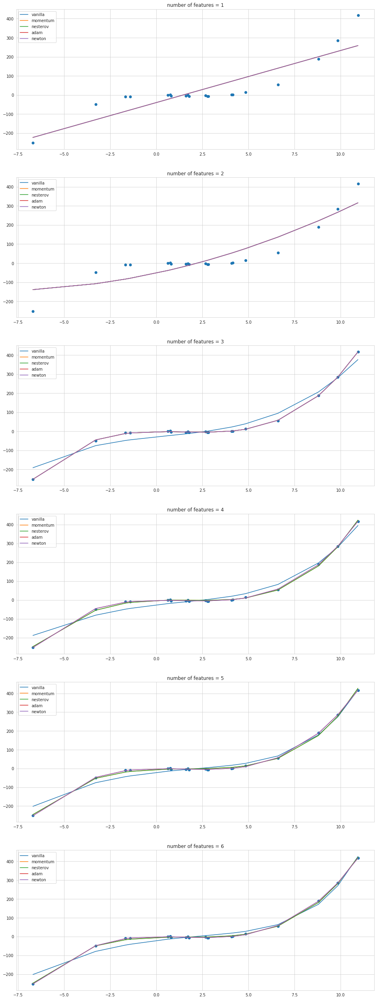

In [70]:
def vanilla_gd(theta, X, Y, rate):
    i = 0
    n = float(X.shape[0])
    g = (1 / n) * (X.T @ ((X @ theta) - y))
    while i < 1000 and np.linalg.norm(g) > 1e-8:
        g = (1 / n) * (X.T @ ((X @ theta) - y))
        theta = theta - rate * g
        i += 1
    return theta

def momentum(theta, X, Y, rate, alpha):
    i = 0
    n = float(X.shape[0])
    g = (1 / n) * (X.T @ ((X @ theta) - y))
    delta = 0
    while i < 1000 and np.linalg.norm(g) > 1e-8:
        g = (1 / n) * (X.T @ ((X @ theta) - y))
        delta = alpha * delta - rate * g
        theta = theta + delta
        i += 1
    return theta

def nesterov(theta, X, Y, rate, alpha):
    i = 0
    n = float(X.shape[0])
    g = (1 / n) * (X.T @ ((X @ theta) - y))
    delta = 0
    while i < 1000 and np.linalg.norm(g) > 1e-8:
        g = (1 / n) * (X.T @ ((X @ (alpha * delta + theta)) - y))
        delta = alpha * delta - rate * g
        theta = theta + delta
        i += 1
    return theta

def adam(theta, X, Y, rate, beta1, beta2, epsilon):
    i = 1
    m, v = 0, 0
    n = float(X.shape[0])
    g = (1 / n) * (X.T @ ((X @ theta) - y))
    while np.linalg.norm(g) > 1e-5:
        g = (1 / n) * (X.T @ ((X @ theta) - y))

        m = beta1 * m + (1 - beta1) * g
        mt = m / (1 - (beta1**i))
        v = beta2 * v + (1 - beta2) * (g**2)
        vt = v / (1 - (beta2**i))
        delta = -(rate * mt) / (np.sqrt(vt) + epsilon)

        theta = theta + delta
        i += 1
    return theta

def newton(theta, X, Y):
    i = 0
    n = float(X.shape[0])
    g = (1 / n) * (X.T @ ((X @ theta) - y))
    while i < 1000 and np.linalg.norm(g) > 1e-8:
        g = (1 / n) * (X.T @ ((X @ theta) - y))
        h = (1 / n) * (X.T @ X)
        theta = theta - np.linalg.inv(h) @ g
        i += 1
    return theta

x = np.sort(2 - 3 * np.random.normal(0, 1, 20))
y = x - 2 * (x ** 2) + 0.5 * (x ** 3) + np.random.normal(-3, 3, 20)
x = x.reshape((-1, 1))
m = x.shape[0]
x = np.hstack((np.ones((m, 1)), x))

fig, ax = plt.subplots(6, 1, figsize=(16, 9*5))
for i in range(2, 8):
    #x = np.hstack((x, (x[:, 1] ** 2).reshape((m, 1)), (x[:, 1] ** 3).reshape((m, 1)), (x[:, 1] ** 4).reshape((m, 1))))
    #x[:, 1:] = (x[:, 1:] - np.mean(x[:, 1:], axis=0)) / np.std(x[:, 1:], axis=0)

    theta = np.random.random(x.shape[1])
    theta_vanilla = vanilla_gd(theta, x, y, 0.01)
    theta_momentum = momentum(theta, x, y, 0.01, 0.9)
    theta_nesterov = nesterov(theta, x, y, 0.01, 0.9)
    theta_adam = adam(theta, x, y, 0.001, 0.9, 0.999, 1e-8)
    theta_newton = newton(theta, x, y)
    ax[i - 2].scatter(x[:, 1], y)
    ax[i - 2].plot(x[:, 1], x @ theta_vanilla, label='vanilla')
    ax[i - 2].plot(x[:, 1], x @ theta_momentum, label='momentum')
    ax[i - 2].plot(x[:, 1], x @ theta_nesterov, label='nesterov')
    ax[i - 2].plot(x[:, 1], x @ theta_adam, label='adam')
    ax[i - 2].plot(x[:, 1], x @ theta_newton, label='newton')
    ax[i - 2].set_title("number of features = {}".format(x.shape[1] - 1))
    ax[i - 2].legend()

    x = np.hstack((x, (x[:, 1] ** i).reshape((m, 1))))
    x[:, -1] = (x[:, -1] - np.mean(x[:, -1], axis=0)) / np.std(x[:, -1], axis=0)

On remarque qu'avec l'augmentation du nombre de features (c'est à dire l'augmentation du degré du polynome) on a tendance a davantage coller aux données. L'orsque le polynome a un degré trop grand, on colle trop aux données pour pouvoir faire de la prediction sur des données test non vues. C'est de l'overfitting. Pour mieux generaliser il faudrait introduire de la regularisation par exemple en baissant le degré du polynome ou en réduisant le nombre d'iterations.